<h1>Team 30 - DS4A Colombia 4.0 - Week 3<h1>

-------



##  Relationship between water quality and money in the US: A data analytical approach

**Margarita Palacios Vargas, Julián Gómez García, Leonardo Briceño Montaña, Cristhian Córdoba, and Joham Alvarez Montoya**

5th December 2020

<br/>




<h3>OVERVIEW<h3>

<p>In this submission, we present the Exploratory Data Analysis of our final project of the DS4A Colombia 4.0 course.</p>

-------

<h3>TOPIC AND FOCUS</h3>

<p>Water is the key to living. Most of our problems with politics and economics are small compared with a possible future without access to clean water. The issue of not being able to get a high-paying job can be negligible compared to the problem of not having clean water. However, some people think that water and environmental care produce a decrease in productivity, therefore, earnings and profitability of industries are decreased and people become consequently poorer (Clevenger, T., & Herbert, M., 2020). 
The aim of this project is to discover hidden patterns between water quality and money in order to get insights into whether environmental carelessness produces more money as many non-enviromentalists argue. 
The research question to resolve is: <h3>**“What is the relationship between profitability/income of industries and water quality in the United States counties between 2010 and 2016?”**</h3>

To accomplish this, three datasets were selected: chemicals provided by the Center of Disease Control and Prevention (information about water quality from 2000 to 2016 in the US), earnings from US Census (information about profitability from 2010 to 2016 in the US) and industry occupation also from US Census (information about the location of industrial sectors from 2010 to 2016). In addition, as a reference dataset, water usage provided by the US Department of the Interior (information about the share of water usage in the US from 2010) is also expected to be used. No external datasets are required to respond to the stated question.</p>


-------

<h3>DATA WRANGLING</h3>

<p>The datasets that we will use enable us to establish relationships between the following county  variables: earnings, level of contamination/chemicals in the water, water usage, and industrial activities. These data sets and different variables allow us to demonstrate and analyze the different relationships that are of interest to us as a research team.</p>

-------

<h3>HYPOTHESES<h3>
<ul>
<li>Check if there is a significant difference between the median earnings of the counties and the number of contaminants in the water above the allowed level.</li>

<li>In those counties with contaminants above the allowed there is the presence of a particular type of industry or group of industries</li>
</ul>

-------

<h3>PRELIMINARY PLAN<h3>
<ul>
<li>Generate the median earnings of the counties for each year</li>
<li>Check which counties are above and below the median earnings level</li>
<li>Check the contaminant level in the water by county</li>
<li>Verify the contaminant level in the water by county above the allowed</li>
<li>Cross the counties with the most polluted water vs the counties with more or less earning</li>
<li>Check if there is any relationship in the previous crossing </li>
<li>Identify the 5 industries with the highest average earnings in those countries with a chemical contaminant above the allowable</li>
<li>Count the number of times each industry is repeated and test if there is a group of industries with high frequency</li>
</ul>

-------

# DATA ANALYSIS
****

## Recognizing, describing and cleaning the data

###### i. First things first: Import libraries of interest.

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from scipy import stats
from statsmodels.formula.api import ols
import sklearn as sk
import statsmodels.formula.api as smf
import statsmodels.api         as sm

###### ii. Useful documentation:
* <a href="https://www.earthdatascience.org/courses/intro-to-earth-data-science/file-formats/use-text-files/format-text-with-markdown-jupyter-notebook/" target="_blank">Format Text In Jupyter Notebook</a>
* <a href="https://stackoverflow.com/questions/8924173/how-do-i-print-bold-text-in-python" target="_blank">How do I print bold text in Python?</a>
* <a href="https://www.nrcs.usda.gov/wps/portal/nrcs/detail/ny/home/?cid=nrcs143_013696" target="_blank">Every State FIPS code</a>
* <a href="https://www.nrcs.usda.gov/wps/portal/nrcs/detail/national/home/?cid=nrcs143_013697" target="_blank">Every County FIPS code</a>


****
### I. Chemicals Data Set

In [2]:
#Load Chemicals and preview
df_chemicals = pd.read_csv("datasets/chemicals.csv")
df_chemicals.head(3).append(df_chemicals.tail(3))

,cws_name,chemical_species,contaminant_level,county,pws_id,pop_served,state,unit_measurement,value,year,fips,state_fips
0,CALIFORNIA WATER SERVICE - LIVERMORE,Uranium,Less than or equal MCL,Alameda,CA0110003,57200,California,micrograms/L,1.54,2000,6001,6
1,CITY OF LIVERMORE,Uranium,Less than or equal MCL,Alameda,CA0110011,26400,California,micrograms/L,1.64,2000,6001,6
2,CITY OF PLEASANTON,Uranium,Less than or equal MCL,Alameda,CA0110008,70600,California,micrograms/L,1.64,2000,6001,6
882316,PORT EDWARDS WATERWORKS,Trihalomethane,Less than or equal MCL,Wood,WI7720113,1866,Wisconsin,micrograms/L,4.70,2016,55141,55
882317,VESPER WATERWORKS,Trihalomethane,Less than or equal MCL,Wood,WI7720134,641,Wisconsin,micrograms/L,68.90,2016,55141,55
882318,WIS RAPIDS WATER WORKS & LIGHTING COMM,Trihalomethane,Less than or equal MCL,Wood,WI7720108,20000,Wisconsin,micrograms/L,53.46,2016,55141,55


#### First Impressions:
* Probably won't be using the name of the Water systems per County.
* Must look through each String Variable
* Must look for coherence between County-Fips and State-State Fips.

****
### a) Recognizing variables and checking for null observations

In [3]:
#Recognition of the variables available
print(df_chemicals.info())
print()

#Null observations checking.
print(df_chemicals.isnull().any())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 882319 entries, 0 to 882318
Data columns (total 12 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   cws_name           882319 non-null  object 
 1   chemical_species   882319 non-null  object 
 2   contaminant_level  882319 non-null  object 
 3   county             882319 non-null  object 
 4   pws_id             882319 non-null  object 
 5   pop_served         882319 non-null  int64  
 6   state              882319 non-null  object 
 7   unit_measurement   882319 non-null  object 
 8   value              882319 non-null  float64
 9   year               882319 non-null  int64  
 10  fips               882319 non-null  int64  
 11  state_fips         882319 non-null  int64  
dtypes: float64(1), int64(4), object(7)
memory usage: 80.8+ MB
None

cws_name             False
chemical_species     False
contaminant_level    False
county               False
pws_id               False

##### Conclusions:
* Every record is complete.
* There's not null data we need to handle.
* We must know what information is present inside each variable.
****

### b) Recognizing observations per variable of interest

#### VARIABLE TYPE: STRING

#### 1. 'chemical_species'

In [4]:
list(df_chemicals['chemical_species'].unique())

['Uranium',
 'Arsenic',
 'DEHP',
 'Nitrates',
 'Halo-Acetic Acid',
 'Trihalomethane']

           chemical   count  percentage
0          Nitrates  329372    0.373303
1    Trihalomethane  154258    0.174832
2  Halo-Acetic Acid  146132    0.165623
3           Arsenic  142001    0.160941
4              DEHP   72825    0.082538
5           Uranium   37731    0.042763
AxesSubplot(0.125,0.125;0.775x0.755)


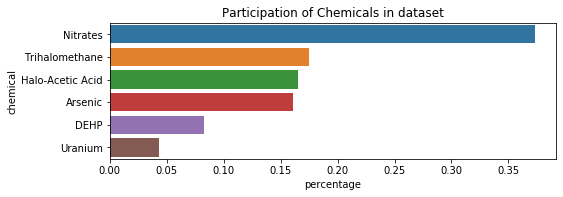

In [5]:
aux=pd.DataFrame(df_chemicals['chemical_species'].value_counts()).reset_index()
aux.columns=['chemical','count']
aux['percentage']=aux['count']/sum(aux['count'])
print(aux)

plt.figure(figsize=(8, 2.5))
plt.title("Participation of Chemicals in dataset")
#sns.barplot(x=list(df_chemicals['chemical_species'].unique()),y=df_chemicals['chemical_species'].value_counts())
print(sns.barplot(x=aux['percentage'],y=aux['chemical']))

##### Conclusions:
* The span of our data is 6 contaminants we don't know much about.
* Nitrates appear a third of the whole records in the data set.

***
<ul><h5> General description and industry-usage of this chemicals</h5></ul>

<b>Uranium:</b> (<a href="https://www.who.int/ionizing_radiation/pub_meet/en/Depluranium2.pdf?ua=1" target="_blank">source</a>):</ul></b>
* Uranium is weakly radioactive because all isotopes of uranium are unstable

<ul><b>Industry Uses:</b></ul>

* Radiation shielding
*  Counterbalance weights and ballast Vessels and equipment, such as boats and satellites require a large amount of weight to be carried in the form of ballast. 
* Military Uses Depleted uranium (and associated uranium-titanium alloys [typically 0.75 wt % Ti]) have been employed by the military as a component of heavy tank armour and armour-piercing munitions
* Nuclear power plants.

<b>Arsenic:</b> (<a href="https://www.who.int/news-room/fact-sheets/detail/arsenic#:~:text=Arsenic%20is%20naturally%20present%20at,toxic%20in%20its%20inorganic%20form.&text=Long%2Dterm%20exposure%20to%20arsenic,with%20cardiovascular%20disease%20and%20diabetes" target="_blank">source</a>):</ul></b>

* Arsenic is naturally present at high levels in the groundwater of a number of countries.
* Arsenic is highly toxic in its inorganic form.
* Long-term exposure to arsenic from drinking-water and food can cause cancer and skin lesions. It has also been associated with cardiovascular disease and diabetes. In utero and early childhood exposure has been linked to negative impacts on cognitive development and increased deaths in young adults.

<ul><b>Industry Uses:</b></ul>

* Arsenic is a natural component of the earth’s crust and is widely distributed throughout the environment in the air, water and land
* Arsenic is used industrially as an alloying agent, as well as in the processing of glass, pigments, textiles, paper, metal adhesives, wood preservatives and ammunition. 
* Arsenic is also used in the hide tanning process and, to a limited extent, in pesticides, feed additives and pharmaceuticals.
* People who smoke tobacco can also be exposed to the natural inorganic arsenic content of tobacco because tobacco plants can take up arsenic naturally present in the soil. Also, in the past, the potential for elevated arsenic exposure was much greater when tobacco plants used to be treated with lead arsenate insecticide

<b>DEHP (<a href="https://en.wikipedia.org/wiki/Bis(2-ethylhexyl)_phthalate" target="_blank">source</a>):</ul></b>
* Organic compound
* Colorless viscous liquid soluble in oil, but not in water.

<ul><b>Industry Uses:</b></ul>

* Due to its suitable properties and the low cost, DEHP is widely used as a plasticizer in manufacturing of articles made of *PVC*. *PVC* is used extensively in *sewage pipe* due to its low cost, chemical resistance, and ease of jointing.
* *Plastics* may contain 1% to 40% of DEHP.
* Used as a *hydraulic fluid* and as a dielectric fluid in *capacitors*.
* Use as a solvent in *glowsticks*.
* DEHP is a component of *many household items*, including tablecloths, floor tiles, shower curtains, garden hoses, rainwear, dolls, toys, shoes, medical tubing, furniture upholstery, and swimming pool liners.
*  Common exposures come from the use of DEHP as a fragrance carrier in cosmetics, personal care products, laundry detergents, colognes, scented candles, and air fresheners.
* **DEHP can leach into drinking water from discharges from rubber and chemical factories**


<b>Nitrates:</b> (<a href="https://www.health.state.mn.us/communities/environment/water/contaminants/nitrate.html#MinnesotaWater" target="_blank">source</a>):</ul></b>
* Nitrate is a compound that naturally occurs and has many human-made sources.

<ul><b>Industry Uses:</b></ul>

* It is often difficult to pinpoint sources of nitrates because there are so many possibilities.
* Sources of nitrogen and nitrates may include runoff or seepage from fertilized agricultural lands, municipal and industrial waste water, refuse dumps, animal feedlots, septic tanks and private sewage disposal systems, urban drainage and decaying plant debris. 
* Geologic formations and direction of ground water flow also may influence nitrate concentration.

<b>Halo-Acetic Acid:</b> (<a href="https://www.simcoemuskokahealth.org/Topics/SafeWater/drinkingwater/chemicalsminerals/Haloacetic-Acids-in-Drinking-Water#:~:text=Haloacetic%20acids%20(HAAs)%20are%20a,matter%20in%20the%20source%20water." target="_blank">source</a>):</ul></b>
* Haloacetic acids (HAAs) are a group of compounds that can form in the water distribution systems when chlorine used to disinfect drinking water reacts with naturally occurring organic matter in the source water

<ul><b>Industry Uses:</b></ul>

* It is often difficult to pinpoint sources of nitrates because there are so many possibilities.
* Sources of nitrogen and nitrates may include runoff or seepage from fertilized agricultural lands, municipal and industrial waste water, refuse dumps, animal feedlots, septic tanks and private sewage disposal systems, urban drainage and decaying plant debris. 
* Geologic formations and direction of ground water flow also may influence nitrate concentration.

<b>Trihalomethane:</b> </b> (<a href="https://www.simcoemuskokahealth.org/Topics/SafeWater/drinkingwater/chemicalsminerals/Haloacetic-Acids-in-Drinking-Water#:~:text=Haloacetic%20acids%20(HAAs)%20are%20a,matter%20in%20the%20source%20water." target="_blank">source</a>):</ul></b>
* Trihalomethanes (THMs) are chemical compounds in which three of the four hydrogen atoms of methane (CH4) are replaced by halogen atoms.
* Many trihalomethanes find uses in industry as solvents or refrigerants.

<ul><b>Industry Uses:</b></ul>

* Trifluoromethane and chlorodifluoromethane are both used as refrigerants. Trihalomethanes released to the environment break down faster than chlorofluorocarbons (CFCs), thereby doing much less damage to the ozone layer.
* Chloroform is a common solvent in organic chemistry.
* Trihalomethanes are formed as a by-product predominantly when chlorine is used to disinfect drinking water. They are generally referred to as disinfection by-products.

***
#### 2. 'contaminant_level'

In [6]:
list(df_chemicals['contaminant_level'].unique())

['Less than or equal MCL', 'Non Detect', 'Greater than MCL']

        contaminant_level   count  percentage
0  Less than or equal MCL  503954    0.571170
1              Non Detect  364820    0.413479
2        Greater than MCL   13545    0.015352
AxesSubplot(0.125,0.125;0.775x0.755)


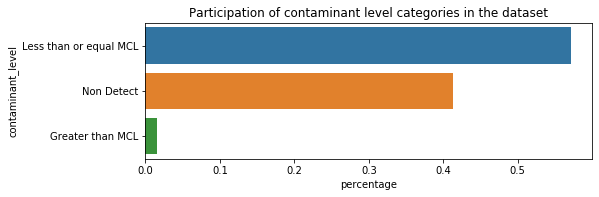

In [7]:
df_chemicals['contaminant_level'].value_counts()
aux=pd.DataFrame(df_chemicals['contaminant_level'].value_counts()).reset_index()
aux.columns=['contaminant_level','count']
aux['percentage']=aux['count']/sum(aux['count'])
print(aux)

plt.figure(figsize=(8, 2.5))
plt.title("Participation of contaminant level categories in the dataset")
#sns.barplot(x=list(df_chemicals['chemical_species'].unique()),y=df_chemicals['chemical_species'].value_counts())
print(sns.barplot(x=aux['percentage'],y=aux['contaminant_level']))

##### Conclusions:
* Span of 3 possible categories.
* *MCL* stands for *Maximum Contaminant Level*

***
#### 3. 'state' and 'state_fips'

In [8]:
#Have the names of the States a unique 'state_fips' code?
len_county=len(df_chemicals['state'].unique())
len_fips=len(df_chemicals['state_fips'].unique())
print('\033[1m We have {0:.0f} State names and {1:.0f} State codes for those names.'.format(len_county,len_fips))

 We have 27 State names and 27 State codes for those names.


AxesSubplot(0.125,0.125;0.775x0.755)


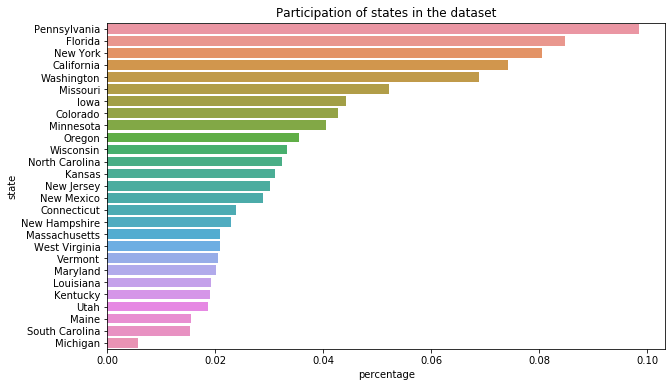

In [9]:
aux=pd.DataFrame(df_chemicals['state'].value_counts()).reset_index()
aux.columns=['state','count']
aux['percentage']=aux['count']/sum(aux['count'])
aux['acc_percentage']=aux['count'].cumsum()/sum(aux['count'])
#print(aux)

plt.figure(figsize=(10, 6))
plt.title("Participation of states in the dataset")
#sns.barplot(x=list(df_chemicals['chemical_species'].unique()),y=df_chemicals['chemical_species'].value_counts())
print(sns.barplot(x=aux['percentage'],y=aux['state']))
#print(sns.barplot(x=aux['acc_percentage'],y=aux['state']))

##### Conclusions:
* We have 27 county names and 27 county codes for those names
* We can use the name or the fips code for States.
* From Conneticut to Pennsylvania we have the 80% of the records.

***
#### 4. 'county' and 'fips'

In [10]:
#Have the names of the Counties a unique 'fips' code?
len_county=len(df_chemicals['county'].unique())
len_fips=len(df_chemicals['fips'].unique())
print('\033[1m *We have {0:.0f} County names and {1:.0f} County codes for those names.\n'.format(len_county,len_fips))
print('\033[1m **Are there County names that have more than 1 fips code?')

 *We have 1045 County names and 1500 County codes for those names.

 **Are there County names that have more than 1 fips code?


In [11]:
#County and State data in one place
df_county_fips=pd.concat([df_chemicals['county'],df_chemicals['fips'],df_chemicals['state'],df_chemicals['state_fips']],axis=1).drop_duplicates()
df_county_fips

,county,fips,state,state_fips
0,Alameda,6001,California,6
89,Alpine,6003,California,6
101,Amador,6005,California,6
140,Butte,6007,California,6
329,Calaveras,6009,California,6
...,...,...,...,...
639435,Van Buren,26159,Michigan,26
639466,Washtenaw,26161,Michigan,26
639541,Wayne,26163,Michigan,26
639756,Wexford,26165,Michigan,26


In [12]:
dup_counties=df_county_fips.groupby('county').agg({'fips':'count'})
dup_counties.rename(columns={'fips':'n_fips_dupl'},inplace=True)
print(dup_counties[dup_counties.n_fips_dupl>1])
print()
print('\033[1m *Yes! There are names of Counties that have more than 1 fips code.\n')
print('\033[1m **Is it a mistake or could there be Counties with the same name in different States?')
print('\033[1m   Lets check top and bottom 2.')

           n_fips_dupl
county                
Adair                3
Adams                5
Allegany             2
Allen                3
Anderson             3
...                ...
Worcester            2
Worth                2
Wright               3
Wyoming              3
York                 3

[190 rows x 1 columns]

 *Yes! There are names of Counties that have more than 1 fips code.

 **Is it a mistake or could there be Counties with the same name in different States?
   Lets check top and bottom 2.


In [13]:
df_county_fips[df_county_fips.county=='Adair']

,county,fips,state,state_fips
17923,Adair,19001,Iowa,19
18760,Adair,21001,Kentucky,21
100892,Adair,29001,Missouri,29


In [14]:
df_county_fips[df_county_fips.county=='Adams']

,county,fips,state,state_fips
12361,Adams,8001,Colorado,8
32167,Adams,42001,Pennsylvania,42
37253,Adams,55001,Wisconsin,55
74529,Adams,19003,Iowa,19
160600,Adams,53001,Washington,53


In [15]:
df_county_fips[df_county_fips.county=='Wyoming']

,county,fips,state,state_fips
28424,Wyoming,36121,New York,36
35628,Wyoming,42131,Pennsylvania,42
37252,Wyoming,54109,West Virginia,54


In [16]:
df_county_fips[df_county_fips.county=='York']

,county,fips,state,state_fips
35692,York,42133,Pennsylvania,42
36149,York,45091,South Carolina,45
89965,York,23031,Maine,23


###### Anyway, let's make sure that no name is repeated in a single State.

In [17]:
df_county_fips=pd.merge(df_county_fips, dup_counties, how='left', left_on='county', right_on='county')
dup_counties_states=df_county_fips.groupby(['county','state']).size()
dup_counties_states.rename('n_state_fips_dupl',inplace=True)
print("\033[1m *The maximum ammount of times a name of a County belongs to a specific State, in our dataset, is {0:.0f}.".format(dup_counties_states.max()))

 *The maximum ammount of times a name of a County belongs to a specific State, in our dataset, is 1.


In [18]:
aux=pd.DataFrame(df_chemicals['fips'].value_counts()).reset_index()
aux.columns=['fips','count']
aux['percentage']=aux['count']/sum(aux['count'])
aux['acc_percentage']=aux['count'].cumsum()/sum(aux['count'])
aux['fips']=aux['fips'].astype(str)

#Fips with its' State

county_code = pd.concat([df_chemicals['fips'],df_chemicals['state']],axis=1)
county_code.drop_duplicates(inplace=True)
county_code.reset_index(drop=True,inplace=True)
print(county_code)

#aux['fips']=pd.merge(aux['fips'],df_chemicals['state'],how='left',on='fips')
print(aux)
aux2=aux[aux.acc_percentage<0.8]
print(aux2)

#plt.figure(figsize=(10, 6))
#plt.title("Participation of the counties in the dataset")
#sns.barplot(x=list(df_chemicals['chemical_species'].unique()),y=df_chemicals['chemical_species'].value_counts())
#print(sns.barplot(x=aux['percentage'],y=aux['fips']))
#print(sns.barplot(x=aux['acc_percentage'],y=aux['state']))

       fips       state
0      6001  California
1      6003  California
2      6005  California
3      6007  California
4      6009  California
...     ...         ...
1495  26159    Michigan
1496  26161    Michigan
1497  26163    Michigan
1498  26165    Michigan
1499  29173    Missouri

[1500 rows x 2 columns]
       fips  count  percentage  acc_percentage
0     12105   7670    0.008693        0.008693
1     12057   7490    0.008489        0.017182
2     53053   6712    0.007607        0.024789
3     53029   6250    0.007084        0.031873
4      6037   5989    0.006788        0.038661
...     ...    ...         ...             ...
1495  26127      6    0.000007        0.999978
1496  26001      6    0.000007        0.999985
1497  26079      6    0.000007        0.999992
1498  26143      4    0.000005        0.999997
1499  26003      3    0.000003        1.000000

[1500 rows x 4 columns]
      fips  count  percentage  acc_percentage
0    12105   7670    0.008693        0.008693
1    1

##### Conclusions:
* Fips codes are unique.
* There are names of Counties (190) that have more than 1 fips code.
* A County name never repeats within a State.
* We must use the Counties' code (fips), when studying the information with Counties as a Factor variable.
* The County with most records have 0.87% of the overall.

***
#### 5. 'cws_name' and 'pws_id'

In [19]:
#Count Water Sources by year, fips, chemical.
hilfe1=df_chemicals.groupby(['year','fips','chemical_species','cws_name'])['value'].count()
print(max(hilfe1))
print('\n\033[1mThere are Water Sources that appear more than 1 time.')
print('\n\033[1mIn the following table we can see some of them. Let\'s filter the first one.')
#Show Table
hilfe1=hilfe1.reset_index()
hilfe1[hilfe1.value>1].reset_index()

2

There are Water Sources that appear more than 1 time.

In the following table we can see some of them. Let's filter the first one.


,index,year,fips,chemical_species,cws_name,value
0,11849,1999,34037,Nitrates,HARDYSTON TWP MUA,2
1,14641,1999,42089,Nitrates,POCONO MOBILE HOME ESTATES,2
2,21257,2000,8051,Arsenic,COUNTRY MEADOWS MOBILE ESTATES,2
3,35109,2000,34007,Arsenic,WINSLOW TWP DMU,2
4,35129,2000,34007,Nitrates,WINSLOW TWP DMU,2
...,...,...,...,...,...,...
277,862560,2016,41017,DEHP,WATER WONDERLAND IMPROV D,2
278,862627,2016,41017,Nitrates,WATER WONDERLAND IMPROV D,2
279,876151,2016,53037,Arsenic,KITTITAS COUNTY WATER DISTRICT,2
280,876173,2016,53037,Nitrates,KITTITAS COUNTY WATER DISTRICT,2


In [20]:
hilfe2=df_chemicals[(df_chemicals.year==1999) 
                    & (df_chemicals.fips==34037) 
                    & (df_chemicals.chemical_species=='Nitrates') 
                    & (df_chemicals.cws_name=='HARDYSTON TWP MUA')]
hilfe2

,cws_name,chemical_species,contaminant_level,county,pws_id,pop_served,state,unit_measurement,value,year,fips,state_fips
432004,HARDYSTON TWP MUA,Nitrates,Less than or equal MCL,Sussex,NJ1911006,1963,New Jersey,milligrams/L,1.53,1999,34037,34
432005,HARDYSTON TWP MUA,Nitrates,Less than or equal MCL,Sussex,NJ1911005,769,New Jersey,milligrams/L,1.46,1999,34037,34


In [21]:
#Count Water Sources by year, fips, chemical.
hilfe3=df_chemicals.groupby(['year','fips','chemical_species','pws_id'])['value'].count()
print(max(hilfe3))
print('\n\033[1mAs we thought we must use the Water Sources by their code, much like for Counties.')

1

As we thought we must use the Water Sources by their code, much like for Counties.


In [22]:
#Count Water Sources by year, fips, chemical.
hilfe4=df_chemicals.groupby(['year','chemical_species','pws_id'])['value'].count()
print(max(hilfe4))

print('\n\033[1mEvery Water Source code appear a unique time, per year, chemical and County.')

1

Every Water Source code appear a unique time, per year, chemical and County.


In [23]:
aux6=df_chemicals[(df_chemicals.year==1999) 
                  & (df_chemicals.fips==8001) 
                  & (df_chemicals.chemical_species=='Arsenic')]
aux6.reset_index(inplace=True,drop=True)
print('\n\033[1m\tHere comes an example of the data por a year, a County and a chemical. We can see several Water Sources. Because our analysis starts at the level County we must figure out what to do with this Water Sources.')
aux6


	Here comes an example of the data por a year, a County and a chemical. We can see several Water Sources. Because our analysis starts at the level County we must figure out what to do with this Water Sources.


,cws_name,chemical_species,contaminant_level,county,pws_id,pop_served,state,unit_measurement,value,year,fips,state_fips
0,BENNETT TOWN OF,Arsenic,Non Detect,Adams,CO0101020,2900,Colorado,micrograms/L,0.5,1999,8001,8
1,BRIGHTON CITY OF,Arsenic,Non Detect,Adams,CO0101025,32700,Colorado,micrograms/L,0.5,1999,8001,8
2,GALAMBS MOBILE HOME AND RV PARK,Arsenic,Non Detect,Adams,CO0101060,130,Colorado,micrograms/L,0.5,1999,8001,8
3,GREATROCK NORTH WSD,Arsenic,Non Detect,Adams,CO0101063,936,Colorado,micrograms/L,0.5,1999,8001,8
4,NORTHGLENN CITY OF,Arsenic,Non Detect,Adams,CO0101115,35357,Colorado,micrograms/L,1.0,1999,8001,8
5,SOUTH ADAMS COUNTY WSD,Arsenic,Less than or equal MCL,Adams,CO0101140,51465,Colorado,micrograms/L,4.8,1999,8001,8
6,STRASBURG WSD,Arsenic,Non Detect,Adams,CO0101145,1950,Colorado,micrograms/L,0.5,1999,8001,8
7,THORNTON CITY OF,Arsenic,Less than or equal MCL,Adams,CO0101150,134988,Colorado,micrograms/L,1.5,1999,8001,8
8,TODD CREEK VILLAGE MD,Arsenic,Non Detect,Adams,CO0101157,2700,Colorado,micrograms/L,0.5,1999,8001,8
9,WESTMINSTER CITY OF,Arsenic,Non Detect,Adams,CO0101170,154000,Colorado,micrograms/L,0.5,1999,8001,8


##### Conclusions:
* For the purposes of the analysis we must use the code of the Water Sources (pws_id), because there are names that repeat in the records
* Theres a unique code of Water Source for every County, per year.
* We must summarize the data per County, to conclude at this level. Water Sources are not the core of this data analysis.

***
#### 6. 'unit_measurement'

In [24]:
list(df_chemicals['unit_measurement'].unique())

['micrograms/L', 'milligrams/L']

In [25]:
df_chemicals.groupby(['chemical_species','unit_measurement'])['value'].count()

chemical_species  unit_measurement
Arsenic           micrograms/L        142001
DEHP              micrograms/L         72825
Halo-Acetic Acid  micrograms/L        146132
Nitrates          milligrams/L        329372
Trihalomethane    micrograms/L        154258
Uranium           micrograms/L         37731
Name: value, dtype: int64

#### Conclusions:
* Span of 2 possible categories.
* In the whole Dataset we can find that each Chemical is recorded with the same unit of measeurement. So there's no need no convert any data within each Chemical.
* Just Nitrates are measured in milligrams.
* Similar nomenclature to be aware when concluding, because *Milli* **>** *Micro*:
    * **Micro=** 1*10^-6
    * **Milli=** 1*10^-3

***
#### VARIABLE TYPE: NUMERIC (INTEGER, FLOAT)

#### 7. 'pop_served'

In [26]:
print(df_chemicals['pop_served'].describe().astype('int64'))

count     882319
mean       10731
std        95200
min            0
25%          118
50%          485
75%         3030
max      8271000
Name: pop_served, dtype: int64


#### Conclusions:
* There are Water Sources that serve no population. This could be adjusted with a ponderation of the values per county, as stated in the asessment of that variables (See 5. 'cws_name' and 'pws_id').

#### 8. 'value'

In [27]:
print(df_chemicals['value'].describe())

count    882319.000000
mean          7.434686
std          23.677866
min           0.000000
25%           0.300000
50%           1.000000
75%           4.600000
max        4527.000000
Name: value, dtype: float64


#### Conclusions:
* Remarks should be made in the EDA, ahead.

#### 9. 'year'

In [28]:
print(df_chemicals['year'].describe().astype('int64'))

count    882319
mean       2008
std           4
min        1999
25%        2005
50%        2009
75%        2013
max        2016
Name: year, dtype: int64


#### Conclusions:
* Older information have less records of Water Sources Contamination.
* From 2004 the records seem to have the same values, on average.
* Perhaps we should work with information with the same time frames as the "Earnings" dataset. (2010-2016).

### Bad clasification of "Non Detect" in Arsenic data

In [45]:
hilfe8=df_chemicals[(df_chemicals['chemical_species'] == 'Arsenic') 
             & (df_chemicals['contaminant_level'] == 'Non Detect') 
            & (df_chemicals['value'] == 10)]
print('\n\033[1mThe following table shows wrong classification of the contaminant_level. For values of 10 micrograms/L it is actually the MLC.')
hilfe8.head(5)


The following table shows wrong classification of the contaminant_level. For values of 10 micrograms/L it is actually the MLC.


,cws_name,chemical_species,contaminant_level,county,pws_id,pop_served,state,unit_measurement,value,year,fips,state_fips
38913,CITY OF FRESNO,Arsenic,Non Detect,Fresno,CA1010007,516204,California,micrograms/L,10.0,2003,06019,6
38963,CITY OF FRESNO,Arsenic,Non Detect,Fresno,CA1010007,516204,California,micrograms/L,10.0,2005,06019,6
40089,SWEET WATER CO-OP,Arsenic,Non Detect,Kern,CA1500591,25,California,micrograms/L,10.0,2003,06029,6
47277,GOLDEN STATE WATER CO. - CORDOVA,Arsenic,Non Detect,Sacramento,CA3410015,47810,California,micrograms/L,10.0,2005,06067,6
53108,"MODESTO, CITY OF",Arsenic,Non Detect,Stanislaus,CA5010010,212000,California,micrograms/L,10.0,2003,06099,6


In [46]:
hilfe8=df_chemicals[(df_chemicals['chemical_species'] == 'Arsenic') 
             & (df_chemicals['contaminant_level'] == 'Less than or equal MCL') 
                   & (df_chemicals['value'] == 10)]

print('\n\033[1mThe following table shows right classification of the contaminant_level. For values of 10 micrograms/L it is actually the MLC.')
hilfe8.head(5)


The following table shows right classification of the contaminant_level. For values of 10 micrograms/L it is actually the MLC.


,cws_name,chemical_species,contaminant_level,county,pws_id,pop_served,state,unit_measurement,value,year,fips,state_fips
38618,WILLOW PARK MARINA,Arsenic,Less than or equal MCL,Contra Costa,CA0707507,380,California,micrograms/L,10.0,2009,06013,6
39916,EDMUNDSON ACRES WATER SYSTEM,Arsenic,Less than or equal MCL,Kern,CA1500190,550,California,micrograms/L,10.0,2001,06029,6
40144,OASIS PROPERTY OWNERS ASSOCIATION,Arsenic,Less than or equal MCL,Kern,CA1500585,100,California,micrograms/L,10.0,2004,06029,6
40148,PINON VALLEY WATER COMPANY,Arsenic,Less than or equal MCL,Kern,CA1500540,80,California,micrograms/L,10.0,2004,06029,6
40850,LAMONT PUBLIC UTILITY DIST,Arsenic,Less than or equal MCL,Kern,CA1510012,13471,California,micrograms/L,10.0,2012,06029,6


****
<h3>Earnings Data Set</h3>

In [47]:
df_earnings = pd.read_csv("datasets/earnings.csv", encoding='latin-1')
df_earnings.head(3).append(df_earnings.tail(3))

,geo_id,fips,county,total_med,total_agri_fish_mine,agri_fish_hunt,mining_quarrying_oilgas_extract,construction,manufacturing,wholesale_trade,...,admin_sup,total_edu_health_social,edu_serv,health_social,total_arts_ent_acc_food,arts_ent_rec,acc_food_serv,other_ser,pub_admin,year
0,0500000US01001,1001,"Autauga County, Alabama",31811,31793,31957,22357,30347,44452,38203,...,31250,30306.0,34358,26839,11231,10272,11430,26279,46858,2010
1,0500000US01003,1003,"Baldwin County, Alabama",30099,33173,27342,80938,30068,41917,43444,...,23910,34506.0,37341,30968,14924,17414,14765,21440,38629,2010
2,0500000US01005,1005,"Barbour County, Alabama",23504,16167,14464,27500,20305,27630,18777,...,20179,22398.0,42264,20434,6473,10724,5972,16090,30871,2010
21995,0500000US56041,56041,"Uinta County, Wyoming",30106,82877,34063,86217,23618,61607,55461,...,13722,27728.0,26211,28207,8277,5656,9177,31136,44052,2016
21996,0500000US56043,56043,"Washakie County, Wyoming",32336,29844,25139,54773,38902,38664,36759,...,33365,27305.0,46667,22335,9211,7375,9866,20913,42708,2016
21997,0500000US56045,56045,"Weston County, Wyoming",41058,70375,23173,75417,42650,42102,75000,...,40833,23462.0,23510,22440,20104,33750,14728,23125,40588,2016


#### First Impressions:
* `'county'` here has the County and the State in the same variable as a String. Apparently here we have more Counties than in `Chemicals`, so it could be useful to have the State in a different variable. 
    * **Note:** We don't care about State fips because every state name have its own state fips code. If needed we have all the State (and County) fips codes to merge here
* Must look through each String Variable
* We won't be looking into coherence between county and fips code, because we already have insights in this. Because it's a lot of information we must asume each record is ok.
* We must describe each tag on Industry.

##### Variable Description:
* **geo_id:** ID with the geolocation of each County. Usefull for graph maps.
* **fips:** County Code
* **county:** County and State name
* **total_med:** Total median earnings per County
* **total_agri_fish_mine:** Subtotal median earnings in agriculture, fishing and mining
* **agri_fish_hunt:** Agricultural, Fishing and Hunting median earnings
* **mining_quarrying_oilgas_extract:** Mining, Quarrying, Oil & Gas and other extractive Industries median earnings
* **construction:** Construction Industry median earnings
* **manufacturing:** Manufacturing median earnings
* **wholesale_trade:** Wholesale Trading median earnings
* **retail_trade:** Retail Trading median earnings
* **transport_warehouse_utilities:** Transportation, Warehousing and Utilities median earnings
* **transport_warehouse:** Transport Warehouse median earnings
* **utilities:** Utilities Industry median earnings
* **information:** Information Industry median earnings
* **fin_ins_realest:** Finance and Real Estate Industries median earnings
* **fin_ins:** Financial Industry median earnings
* **realest_rent_lease:** Real Estate Renting and Leasing Industry median earnings
* **total_prof_sci_mgmt_admin:** Subtotal median earnings in proffesional, scientific, management and administrative industries
* **prof_sci_tech:** Proffesional, Scientific and Technology median earnings
* **mgmt:** Management Industry median earnings
* **admin_sup:** Administrative median earnings
* **total_edu_health_social:** Subtotal median earnings in Educational, Healt and Social Industries
* **edu_serv:** Educational median earnings
* **health_social:** Health Industry median earnings
* **total_arts_ent_acc_food:** Subtotal median earnings in Arts, Food, Public Administration, and Other Services
* **arts_ent_rec:** Art Industry median earnings
* **acc_food_serv:** Accomodation and Food median earnings
* **other_ser:** Other Services median earnings
* **pub_admin:** Public Administration median earnings
* **year:** Year of the record.

****
### a) Recognizing variables and checking for null observations

In [48]:
#Recognition of the variables available
print(df_earnings.info())
print()

#Null observations checking.
print(df_earnings.isnull().any())

#Null observations counting.
print(df_earnings.isnull().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21998 entries, 0 to 21997
Data columns (total 31 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   geo_id                           21998 non-null  object 
 1   fips                             21998 non-null  int64  
 2   county                           21998 non-null  object 
 3   total_med                        21998 non-null  int64  
 4   total_agri_fish_mine             21864 non-null  object 
 5   agri_fish_hunt                   21671 non-null  object 
 6   mining_quarrying_oilgas_extract  15751 non-null  object 
 7   construction                     21956 non-null  object 
 8   manufacturing                    21708 non-null  object 
 9   wholesale_trade                  21089 non-null  object 
 10  retail_trade                     21956 non-null  object 
 11  transport_warehouse_utilities    21928 non-null  object 
 12  transport_warehous

##### Conclusions:
* Vital variables (naming: `geo_id`, `county`, `total_med`, `year`), are complete, which is a release.
* Industries with null values are really a cero value, because those Counties had not recieved a penny from those Industries in the year of that specific record. They will be set to cero massively in the dataset.
    * This applies also to sub-totals *(Ex. total_agri_fish_mine)*.
* We must know what information is present inside each variable in general.
****

##### Massive Null Handling
Taking in mind the previous information, in this case sending every null/NaN to cero is reasonable.

In [49]:
#Recognition of the variables available
print(df_earnings.info())
print()

#Null handling
df_earnings.fillna(0, inplace = True)

#Null observations re-checking.
print(df_earnings.isnull().any())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21998 entries, 0 to 21997
Data columns (total 31 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   geo_id                           21998 non-null  object 
 1   fips                             21998 non-null  int64  
 2   county                           21998 non-null  object 
 3   total_med                        21998 non-null  int64  
 4   total_agri_fish_mine             21864 non-null  object 
 5   agri_fish_hunt                   21671 non-null  object 
 6   mining_quarrying_oilgas_extract  15751 non-null  object 
 7   construction                     21956 non-null  object 
 8   manufacturing                    21708 non-null  object 
 9   wholesale_trade                  21089 non-null  object 
 10  retail_trade                     21956 non-null  object 
 11  transport_warehouse_utilities    21928 non-null  object 
 12  transport_warehous

##### Conclusions:
* Nulls handled with success in the whole dataset

### b) Recognizing observations per variable of interest

***
#### 1. 'geo_id', 'fips' and 'county'
* They are related. 
* Because the data has no null variables and is complete we'll assume that there are not mistakes
* We'll be working with the fips code. Since we will be using this variable to merge with other datasets, everything should be fine.
* We have the data of every County and State fips code, so that will help us merging data.


***
#### 2. 'year'

In [50]:
print(df_earnings['year'].describe().astype('int64'))

count    21998
mean      2012
std          2
min       2010
25%       2011
50%       2013
75%       2015
max       2016
Name: year, dtype: int64


In [51]:
df_earnings['year'].value_counts()

2013    3143
2012    3143
2011    3143
2010    3143
2015    3142
2014    3142
2016    3142
Name: year, dtype: int64

In [54]:
df_earnings[df_earnings['mining_quarrying_oilgas_extract'].isnull()]

,geo_id,fips,county,total_med,total_agri_fish_mine,agri_fish_hunt,mining_quarrying_oilgas_extract,construction,manufacturing,wholesale_trade,...,admin_sup,total_edu_health_social,edu_serv,health_social,total_arts_ent_acc_food,arts_ent_rec,acc_food_serv,other_ser,pub_admin,year


In [53]:
df_earnings[df_earnings['construction'].isnull()]

,geo_id,fips,county,total_med,total_agri_fish_mine,agri_fish_hunt,mining_quarrying_oilgas_extract,construction,manufacturing,wholesale_trade,...,admin_sup,total_edu_health_social,edu_serv,health_social,total_arts_ent_acc_food,arts_ent_rec,acc_food_serv,other_ser,pub_admin,year


### Industry

In [55]:
df_industry = pd.read_csv("datasets/industry_occupation.csv", encoding='latin-1')
df_industry.head(3).append(df_industry.tail(3))
df_industry['fips'] = df_industry['fips'].apply(lambda x: str(x).zfill(5))

In [56]:
df_earnings.head(3)

,geo_id,fips,county,total_med,total_agri_fish_mine,agri_fish_hunt,mining_quarrying_oilgas_extract,construction,manufacturing,wholesale_trade,...,admin_sup,total_edu_health_social,edu_serv,health_social,total_arts_ent_acc_food,arts_ent_rec,acc_food_serv,other_ser,pub_admin,year
0,0500000US01001,1001,"Autauga County, Alabama",31811,31793,31957,22357,30347,44452,38203,...,31250,30306.0,34358,26839,11231,10272,11430,26279,46858,2010
1,0500000US01003,1003,"Baldwin County, Alabama",30099,33173,27342,80938,30068,41917,43444,...,23910,34506.0,37341,30968,14924,17414,14765,21440,38629,2010
2,0500000US01005,1005,"Barbour County, Alabama",23504,16167,14464,27500,20305,27630,18777,...,20179,22398.0,42264,20434,6473,10724,5972,16090,30871,2010


In [57]:
df_industry.isnull().sum()
print("Here we have zero null values")

Here we have zero null values


In [58]:
df_industry.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4935 entries, 0 to 4934
Data columns (total 19 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   geo_id                        4935 non-null   object 
 1   fips                          4935 non-null   object 
 2   county                        4935 non-null   object 
 3   state                         4935 non-null   object 
 4   year                          4935 non-null   int64  
 5   total_employed                4935 non-null   float64
 6   agriculture                   4935 non-null   float64
 7   construction                  4935 non-null   float64
 8   manufacturing                 4935 non-null   float64
 9   wholesale_trade               4935 non-null   float64
 10  retail_trade                  4935 non-null   float64
 11  transport_utilities           4935 non-null   float64
 12  information                   4935 non-null   float64
 13  fin

In [59]:
len_county=len(df_industry['county'].unique())
len_fips=len(df_industry['fips'].unique())
print('There are {0:.0f} counties and {1:.0f} fips.'.format(len_county,len_fips))
len_states=len(df_industry['state'].unique())
print('There are {0:.0f} states.'.format(len_states))
print(df_industry['year'].unique())
print('Here we have since 2010 until 2016')

There are 619 counties and 768 fips.
There are 51 states.
[2010 2011 2012 2013 2014 2015 2016]
Here we have since 2010 until 2016


In [ ]:
#Each row of the file is the number of estimated working population
industries=['total_employed','agriculture','construction','manufacturing','wholesale_trade','retail_trade','transport_utilities','information','finance_insurance_realestate','prof_scientific_waste','edu_health','arts_recreation','other','public_admin']
df_industries = pd.DataFrame(industries,columns=['Industries'])
df_industries

In [ ]:
print('All this 14 variables contain the number of estimated working population')

In [ ]:
%matplotlib inline
df_industry['total_employed'].hist(bins=51)

plt.figure(figsize=(12,5))
df_industry.groupby('state').mean()["total_employed"].plot(kind='bar')

In [ ]:
#df_industry.groupby('state').plot.scatter(y='total_employed', x='year')
#plt.show()

### Water Usage

In [ ]:
df_water_usage = pd.read_csv('datasets/water_usage.csv')
df_water_usage['fips'] = df_water_usage['fips'].apply(lambda x: str(x).zfill(5))

In [ ]:
df_water_usage['year'].unique()

In [ ]:
list(df_water_usage.keys())

In [ ]:
df_water_usage

In [ ]:
df_fips_population_year = df_water_usage[['fips','population']]
df_fips_population_year.head()

### Regions

In [ ]:
regions = {'Northeast' : ['Connecticut', 'Maine', 'Massachusetts', 'New Hampshire', 'Rhode Island', 'Vermont', 'New Jersey', 'New York', 'Pennsylvania'],
	'Midwest' : ['Illinois', 'Indiana', 'Michigan', 'Ohio', 'Wisconsin', 'Iowa', 'Kansas', 'Minnesota', 'Missouri', 'Nebraska', 'North Dakota', 'South Dakota'],
	'Southeast' : ['Delaware', 'Florida', 'Georgia', 'Maryland', 'North Carolina', 'South Carolina', 'Virginia', 'District of Columbia', 'West Virginia', 'Alabama', 'Kentucky', 'Mississippi', 'Tennessee', 'Arkansas', 'Louisiana'],
	'Southwest' : ['Arizona', 'New Mexico', 'Oklahoma', 'Texas'],
	'Northwest' : ['Colorado', 'Idaho', 'Montana', 'Nevada', 'Utah', 'Wyoming'],
	'Pacific'   : ['Alaska', 'California', 'Hawaii', 'Oregon', 'Washington']}
regions = dict([(vi, k) for k,v in regions.items() for vi in v])

### Politics

In [ ]:
df_parties=pd.read_csv('datasets/countypres_2000-2016.csv')
df_parties.rename(columns={'FIPS':'fips'},inplace=True)
df_parties.dropna(inplace=True)
df_parties['fips'] = df_parties['fips'].astype(np.int64)
df_parties['fips'] = df_parties['fips'].apply(lambda x: str(x).zfill(5))
df_parties.head(3).append(df_parties.tail(3))

In [ ]:
df_parties.info()

In [ ]:
df_parties['year'].unique()

In [ ]:
A=[2000,2004,2008,2012]
A
for i in A:
    df_parties = df_parties[df_parties.year != i]

df_parties['year'].unique()

In [ ]:
P=df_parties.groupby(['year','state','county','fips','party']).agg({'candidatevotes':'max'}).reset_index()
P.head(5).append(P.tail(5))
#print(P.columns)
df_Parties = P.groupby(['year','state','county','fips'])['candidatevotes'].transform(max) == P['candidatevotes']
P = P[df_Parties]
P.reset_index(drop=True, inplace=True)
print(P)

In [ ]:
P['party'].unique()

In [ ]:
pd.value_counts(P['party'])
P['party'].value_counts().plot(kind='bar', title='Count of parties votes')

In [ ]:
P['party'].value_counts().plot(kind='pie',autopct='%.1f',figsize=(6,6), title='Percentage of parties votes')

# EXPLORATORY DATA ANALYSIS
****

### Adjunting for Water Sources

#### Range of clasification of contaminant_level

In [60]:
umbral_MCL={}
umbral_non_det={}
for chem in list(df_chemicals.chemical_species.unique()):
    umbral_MCL[chem] = df_chemicals[(df_chemicals['chemical_species'] == chem) 
                       & (df_chemicals['contaminant_level'] == 'Less than or equal MCL')]['value'].max()
    umbral_non_det[chem] = df_chemicals[(df_chemicals['chemical_species'] == chem) 
                       & (df_chemicals['contaminant_level'] == 'Non Detect')]['value'].max()

    
umbral_non_det['Arsenic'] = df_chemicals[(df_chemicals['chemical_species'] == 'Arsenic') 
                       & (df_chemicals['contaminant_level'] == 'Less than or equal MCL')]['value'].min()
    
print(umbral_MCL)
umbral_non_det

#df_chemicals.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value > ranged/2), 'contaminant_level'] = 'Upper Less than or equal MCL'
#df_chemicals.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value <= ranged/2), 'contaminant_level'] = 'Lower Less than or equal MCL'

{'Uranium': 30.0, 'Arsenic': 10.0, 'DEHP': 6.0, 'Nitrates': 10.0, 'Halo-Acetic Acid': 60.0, 'Trihalomethane': 80.0}


{'Uranium': 4.48,
 'Arsenic': 0.0,
 'DEHP': 3.0,
 'Nitrates': 1.0,
 'Halo-Acetic Acid': 10.0,
 'Trihalomethane': 5.0}

In [61]:
#Take data only after 2010.
df_chemicals_previous=df_chemicals[df_chemicals.year >= 2010]

#Following code weighs the value of contamination per County and year, within its' Water Sources.
df_chemicals_previous['multiplied_value']=df_chemicals_previous['value']*df_chemicals_previous['pop_served']

help2=df_chemicals_previous.groupby(['year','fips','chemical_species']).agg({'pop_served':'sum'})
help2.rename(columns={'pop_served':'sum_pop_served'},inplace=True)
help2.reset_index(inplace=True)
#help2

df_chemicals_previous=pd.merge(df_chemicals_previous,help2,how='left',on=['year','fips','chemical_species'])
df_chemicals_previous['weighted_value']=df_chemicals_previous['multiplied_value']/df_chemicals_previous['sum_pop_served']

df_chemicals=df_chemicals_previous.groupby(['chemical_species','fips','state','year']).agg({'pop_served':'sum','weighted_value':'sum'})
df_chemicals.reset_index(inplace=True)

df_chemicals['fips'] = df_chemicals['fips'].apply(lambda x: str(x).zfill(5))

#From now on we forget about water sources and focus in Counties' data.

#The following code converts the values for each chemical contamination into its category.
for i in range(len(df_chemicals)):
    if df_chemicals.loc[i,'weighted_value']>umbral_MCL[df_chemicals.loc[i,'chemical_species']]:
        df_chemicals.loc[i,'contaminant_level'] = 'Greater than MCL'
    elif df_chemicals.loc[i,'weighted_value']>umbral_non_det[df_chemicals.loc[i,'chemical_species']]:
        df_chemicals.loc[i,'contaminant_level'] = 'Less than or equal MCL'
    else:
        df_chemicals.loc[i,'contaminant_level'] = 'Non Detect'

df_chemicals.rename(columns={'weighted_value':'value'},inplace=True)
df_chemicals.head(3).append(df_chemicals.tail(3))

C:\Users\joham\Anaconda\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,chemical_species,fips,state,year,pop_served,value,contaminant_level
0,Arsenic,06001,California,2010,2002663,1.000000,Less than or equal MCL
1,Arsenic,06001,California,2011,2002903,1.000395,Less than or equal MCL
2,Arsenic,06001,California,2012,2002663,1.000000,Less than or equal MCL
44179,Uranium,55133,Wisconsin,2014,1796,0.340000,Non Detect
44180,Uranium,55133,Wisconsin,2015,1796,0.500000,Non Detect
44181,Uranium,55133,Wisconsin,2016,1796,1.910000,Non Detect


### Chemicals

Number of reports of chemical concentrations in community water systems in the US, from 2010 to 2016, per year


AttributeError: module 'seaborn' has no attribute 'histplot'

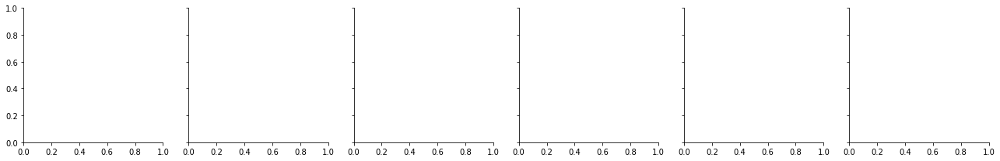

In [62]:
#hue_ord=['Trihalomethane', 'Arsenic', 'Halo-Acetic Acid', 'Uranium', 'DEHP', 'Nitrates']
hue_ord=['Nitrates', 'Arsenic', 'Trihalomethane', 'Halo-Acetic Acid', 'DEHP', 'Uranium']
#print(list(aux4['chemical_species'].unique()))
print('\033[1mNumber of reports of chemical concentrations in community water systems in the US, from 2010 to 2016, per year')
g = sns.FacetGrid(df_chemicals, col='chemical_species');
g.map_dataframe(sns.histplot, x='year' , hue='chemical_species', hue_order=hue_ord);

In [ ]:
print('\033[1mNumber of reports of chemical concentrations higher than the MCL in community water systems in the US, from 2010 to 2016')
g = sns.FacetGrid(df_chemicals[df_chemicals.contaminant_level=='Greater than MCL'], col='chemical_species');
g.map_dataframe(sns.histplot, x='year' , hue='chemical_species', hue_order=hue_ord);

#### Conclusions:
* Nitrates for the periodicity of the study are not recorded as exceeding the MCL.
* DEHP has very punctual times in which MCL is exceeded
    * Both could not explain income with the cualitative variable `contaminant_level`, but the value of contamination could, so we should keep it and see its `significance` explaining it.

In [ ]:
aux5=df_chemicals.groupby(['year','chemical_species'])['contaminant_level'].count()
aux5.rename('count',inplace=True)
aux5=aux5.reset_index()

plt.figure(figsize=(10,3))
sns.lineplot(data=aux5, x='year', y='count', hue='chemical_species', hue_order=hue_ord)
plt.legend(loc='best',fontsize='small')
plt.title('Number of reports of chemical concentrations higher than the MCL in community water systems in the US, from 1999 to 2016, per year');

* **As said before, there's a relationship between Trihalomethane and Halo-Acetic Acid. Both are generated by the reaction of clorine with other compounds found in the water.**
* **Here we can see that the records of this chemicals could have a relation, at the moment of the measure.**

In [ ]:
print('\033[1mNumber of reports of chemical concentrations in community water systems in the US, from 2010 to 2016, per year')
a=df_chemicals.copy()
a['log_pop_served']=np.log(a['pop_served'])
g = sns.FacetGrid(a, col='chemical_species', col_wrap=2, height=2, aspect=3);
g.map_dataframe(sns.violinplot, x='year', y='log_pop_served');

* **Seems not to be substancial change in the population served among Counties, per year and with recordings in their Water Sources of the 6 contaminants in the study.**

In [ ]:
c1 = ols('pop_served ~ year', data=a).fit()  
aov_table = sm.stats.anova_lm(c1, typ=2)
print(aov_table,'\n')

* **We conclude that there is no statistically significant difference between the population served through the years**

In [ ]:
c1 = ols('pop_served ~ year + chemical_species + year*chemical_species', data=df_chemicals).fit()  
aov_table = sm.stats.anova_lm(c1, typ=2)
print(aov_table,'\n')

* **In fact there is no statistically significant difference between the population served through the years.**
* **The interaction between years and chemicals is not significant.**
* **However it seems to be difference between the population served among chemicals.**
    * Say our significance is at a 5%.

In [ ]:
#Does the average population served change through the year, for each chemical
for chem in hue_ord:
    aux = a[a.chemical_species == chem]
    c1 = ols('pop_served ~ year', data=aux).fit()  
    aov_table = sm.stats.anova_lm(c1, typ=2)
    print('\t',chem,'\n',aov_table,'\n')

In [ ]:
plt.figure(figsize=(10,3))
sns.lineplot(x='year', y='pop_served', hue='chemical_species', hue_order=hue_ord, ci=None, data=df_chemicals[(df_chemicals.contaminant_level=='Greater than MCL')
                                                                                                    & (df_chemicals.chemical_species != 'DEHP')])
plt.legend(loc='best',fontsize='medium')
plt.title('Total of population affected by reports of chemical concentrations higher than the MCL in their community water systems in the US, from 1999 to 2016, per year');

* **We could have the presence of an outlier here, to be aware at the moment of creation of the regression models.**

In [ ]:
df_chemicals[(df_chemicals.contaminant_level=='Greater than MCL') 
                      & (df_chemicals.chemical_species == 'Halo-Acetic Acid')
                      & (df_chemicals.pop_served >30000)]

* **A county from NY State has trascended de MCL for Halo-Acetic Acid.**

In [ ]:
df_chemicals[(df_chemicals.chemical_species == 'Halo-Acetic Acid')
                      & (df_chemicals.fips == 36065)]

* **It can be seen that for 2016 that County had a huge rise in this value.**

### Setting up Cloropeth Graphs

#### Population

In [ ]:
import json
#from urllib.request import urlopen
import pandas as pd
import plotly.express as px

#with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
with open('datasets/geojson-counties-fips.json', ) as response:
    counties = json.load(response)
    

df = pd.read_csv(r'datasets/water_usage.csv')
df['state_fips'] = df['state_fips'].apply(lambda x: str(x).zfill(2))
df['county_fips'] = df['county_fips'].apply(lambda x: str(x).zfill(3))
df['fips'] = df[['state_fips', 'county_fips']].apply(lambda x: ''.join(x), axis=1)
#df.head()

fig = px.choropleth(df, geojson = counties, locations ='fips', color='population',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df['population']), 2 * df['population'].mean()),
                           scope = "usa",
                           labels={'population':'population'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

#### Earnings

In [34]:
import json
import pandas as pd
import plotly.express as px
from urllib.request import urlopen

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
#with open('datasets/geojson-counties-fips.json', ) as response:
    counties = json.load(response)

df = pd.read_csv(r'datasets/earnings.csv', encoding = 'latin-1')
df['fips'] = df['fips'].apply(lambda x: str(x).zfill(5))

df_2010 = df[df['year'] == 2010]
df_2011 = df[df['year'] == 2011]
df_2012 = df[df['year'] == 2012]
df_2013 = df[df['year'] == 2013]
df_2014 = df[df['year'] == 2014]
df_2015 = df[df['year'] == 2015]
df_2016 = df[df['year'] == 2016]

fig = px.choropleth(df_2010, geojson = counties, locations ='fips', color='total_med',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2010['total_med']), 2 * df_2010['total_med'].mean()),
                           scope = "usa",
                           labels={'total_med':'Earnings total median [USD]'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

fig = px.choropleth(df_2011, geojson = counties, locations ='fips', color='total_med',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2011['total_med']), 2 * df_2011['total_med'].mean()),
                           scope = "usa",
                           labels={'total_med':'total_med'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

fig = px.choropleth(df_2012, geojson = counties, locations ='fips', color='total_med',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2012['total_med']), 2 * df_2012['total_med'].mean()),
                           scope = "usa",
                           labels={'total_med':'total_med'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

fig = px.choropleth(df_2013, geojson = counties, locations ='fips', color='total_med',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2013['total_med']), 2 * df_2013['total_med'].mean()),
                           scope = "usa",
                           labels={'total_med':'total_med'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Chemicals

## Arsenic

In [37]:
import json
import pandas as pd
import plotly.express as px
#from urllib.request import urlopen

with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
#with open('datasets/geojson-counties-fips.json', ) as response:
    counties = json.load(response)


#df = pd.read_csv(r'datasets/chemicals.csv', encoding = 'latin-1')
df = df_chemicals
df['fips'] = df['fips'].apply(lambda x: str(x).zfill(5))

df_arsenic = df[df['chemical_species'] == 'Arsenic']

df_2010 = df_arsenic[(df_arsenic['year'] == 2010)]
df_2011 = df_arsenic[df_arsenic['year'] == 2011]
df_2012 = df_arsenic[df_arsenic['year'] == 2012]
df_2013 = df_arsenic[df_arsenic['year'] == 2013]
df_2014 = df_arsenic[df_arsenic['year'] == 2014]
df_2015 = df_arsenic[df_arsenic['year'] == 2015]
df_2016 = df_arsenic[df_arsenic['year'] == 2016]

fig = px.choropleth(df_2010, geojson = counties, locations ='fips', color='value',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2010['value']), 4 * df_2010['value'].mean()),
                           scope = "usa",
                           labels={'value':'Content of Arsenic'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig = px.choropleth(df_2011, geojson = counties, locations ='fips', color='value',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2011['value']), 4 * df_2011['value'].mean()),
                           scope = "usa",
                           labels={'value':'value'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig = px.choropleth(df_2012, geojson = counties, locations ='fips', color='value',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2012['value']), 4 * df_2012['value'].mean()),
                           scope = "usa",
                           labels={'value':'value'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig = px.choropleth(df_2013, geojson = counties, locations ='fips', color='value',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2013['value']), 4 * df_2013['value'].mean()),
                           scope = "usa",
                           labels={'value':'value'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig = px.choropleth(df_2014, geojson = counties, locations ='fips', color='value',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2014['value']), 4 * df_2014['value'].mean()),
                           scope = "usa",
                           labels={'value':'value'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig = px.choropleth(df_2015, geojson = counties, locations ='fips', color='value',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2015['value']), 4 * df_2015['value'].mean()),
                           scope = "usa",
                           labels={'value':'value'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Polluting industries

In [39]:
import json
import pandas as pd
import plotly.express as px
#from urllib.request import urlopen


    
df = pd.read_csv(r'datasets/earnings.csv', encoding = 'latin-1')
df['fips'] = df['fips'].apply(lambda x: str(x).zfill(5))

df = df[df['mining_quarrying_oilgas_extract'].notna()]
df = df[df['mining_quarrying_oilgas_extract'].str.isnumeric()]
df['mining_quarrying_oilgas_extract'] = df['mining_quarrying_oilgas_extract'].astype(int)

df = pd.DataFrame(df, columns = ['fips', 'mining_quarrying_oilgas_extract', 'year']) 

df_2010 = df[df['year'] == 2010]
df_2011 = df[df['year'] == 2011]
df_2012 = df[df['year'] == 2012]
df_2013 = df[df['year'] == 2013]
df_2014 = df[df['year'] == 2014]
df_2015 = df[df['year'] == 2015]
df_2016 = df[df['year'] == 2016]

fig = px.choropleth(df_2010, geojson = counties, locations ='fips', color='mining_quarrying_oilgas_extract',
                           color_continuous_scale = "Inferno",
                           range_color=(min(df_2010['mining_quarrying_oilgas_extract']), 5 * df_2010['mining_quarrying_oilgas_extract'].mean()),
                           scope = "usa",
                           labels={'mining_quarrying_oilgas_extract':'mining_quarrying_oilgas_extract'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Merging datasets chemicals and earnings

In [64]:
df_earnings['fips'] = df_earnings['fips'].apply(lambda x: str(x).zfill(5))
df_chemicals['fips'] = df_chemicals['fips'].apply(lambda x: str(x).zfill(5))
temp=df_earnings[['fips','year','total_med']]
merged_df = df_chemicals.merge(temp, how = 'left', on = ['fips', 'year'])
del temp
merged_df

,chemical_species,fips,state,year,pop_served,value,contaminant_level,total_med
0,Arsenic,06001,California,2010,2002663,1.000000,Less than or equal MCL,42407
1,Arsenic,06001,California,2011,2002903,1.000395,Less than or equal MCL,42989
2,Arsenic,06001,California,2012,2002663,1.000000,Less than or equal MCL,43708
3,Arsenic,06001,California,2013,1719000,1.000000,Less than or equal MCL,43769
4,Arsenic,06001,California,2014,1719000,1.000000,Less than or equal MCL,43528
...,...,...,...,...,...,...,...,...
44177,Uranium,55131,Wisconsin,2011,15864,0.520000,Non Detect,38038
44178,Uranium,55133,Wisconsin,2011,9786,0.628672,Non Detect,42416
44179,Uranium,55133,Wisconsin,2014,1796,0.340000,Non Detect,43496
44180,Uranium,55133,Wisconsin,2015,1796,0.500000,Non Detect,43470


In [65]:
merged_df.head(3).append(merged_df.tail(3))

,chemical_species,fips,state,year,pop_served,value,contaminant_level,total_med
0,Arsenic,06001,California,2010,2002663,1.000000,Less than or equal MCL,42407
1,Arsenic,06001,California,2011,2002903,1.000395,Less than or equal MCL,42989
2,Arsenic,06001,California,2012,2002663,1.000000,Less than or equal MCL,43708
44179,Uranium,55133,Wisconsin,2014,1796,0.340000,Non Detect,43496
44180,Uranium,55133,Wisconsin,2015,1796,0.500000,Non Detect,43470
44181,Uranium,55133,Wisconsin,2016,1796,1.910000,Non Detect,44802


In [66]:
merged_df.groupby('state').agg({'total_med':['min', 'max', 'mean','count']})

total_med                           
                     min    max          mean count
state                                              
California         23012  54314  33405.233598  1387
Colorado           17112  56151  31350.052347  2407
Connecticut        33933  49219  41866.892857   336
Florida            19896  39279  28821.380805  2261
Iowa               22088  46272  30754.817815  2975
Kansas             20147  43959  29321.546811  2681
Kentucky           16597  43217  28087.344086  3627
Louisiana          16655  43250  30195.745789  1306
Maine              22686  36187  29329.962891   512
Maryland           26367  62074  39871.428771   716
Massachusetts      31552  51271  39136.600998   401
Michigan           17998  42871  28878.619440   607
Minnesota          22043  46848  31832.051882  2737
Missouri           19633  41764  27466.997471  3163
New Hampshire      28136  43817  34974.134146   328
New Jersey         30998  56990  42921.981402   699
New Mexico         17888  72185  27354.048900  1227
New York           25939  60447  33701.538682  2094
North Carolina     19098  39987  28334.168873  2795
Oregon             22135  40173  28494.205946  1379
Pennsylvania       21951  47558  31573.704571  2647
South Carolina     20800  35869  28221.991025  1337
Utah               18611  56750  29918.102692  1003
Vermont            25808  36572  31830.193662   568
Washington         19685  47190  31235.409125  1315
West Virginia      16772  40492  28231.394318  1760
Wisconsin          24188  44802  31203.024556  1914

In [67]:
pd.crosstab(df_chemicals['state'], df_chemicals['chemical_species'])

chemical_species,Arsenic,DEHP,Halo-Acetic Acid,Nitrates,Trihalomethane,Uranium
state,,,,,,
California,390,238,0,399,0,360
Colorado,418,389,422,448,422,308
Connecticut,56,56,56,56,56,56
Florida,357,380,448,468,448,160
Iowa,430,442,676,657,676,94
Kansas,513,12,646,735,647,128
Kentucky,713,415,810,783,810,96
Louisiana,202,196,382,0,382,144
Maine,112,66,111,112,111,0


In [68]:
merged_df.pivot_table(values='total_med',index='state',columns='year', aggfunc=np.mean)

year,2010,2011,2012,2013,2014,2015,2016
state,,,,,,,
California,32990.582090,33551.502415,33415.257732,33468.273684,33475.553299,33277.833333,33657.820000
Colorado,30300.553517,31363.291291,31167.471264,31318.464986,31685.423188,31677.382353,31872.733894
Connecticut,40807.875000,41705.125000,42093.500000,42145.750000,42082.500000,41885.750000,42347.750000
Florida,28640.579137,28827.836735,28489.825000,28762.858621,28892.991202,28927.614525,29240.381443
Iowa,28626.825123,29747.339713,30226.387387,30889.064103,31572.110048,31775.936321,32473.468514
Kansas,27297.771795,28242.014663,28747.813218,29472.281330,29990.282116,30302.325243,30885.094527
Kentucky,26739.506958,27438.820841,27825.423228,28175.047521,28736.803922,28639.502868,29025.838323
Louisiana,28497.603524,29660.969565,30438.451163,30703.545455,31108.948357,30942.348259,NaN
Maine,28278.486486,28922.943662,29107.671233,29394.111111,29564.800000,29732.200000,30309.625000


* **There are States without an average of income. Should we seek in the data Counties without values in any year, to drop it, or try to infer median income from the rest of the years?**

In [69]:
anios=[2010,2011,2012,2013,2014,2015,2016]
b=list()
a=merged_df.pivot_table(values='total_med',index='fips',columns='year', aggfunc=np.mean)
for i in anios:
    aux=list(a[a[i].isnull()].index)
    b.extend(aux)
    print('year: ',i,', counties with null income: ',len(aux),'/',len(a),'(',round(len(aux)/len(a),3)*100,"%)")
    
b=list(dict.fromkeys(b))
print('\ntotal counties with null in any year:',len(b),'/',len(a),'(',round(len(b)/len(a),3)*100,"%)")

a=a.filter(items=b, axis=0)
#a.reset_index(inplace=True)
a
#c=merged_df[['fips','year','contaminant_level']]
#c
#a=a.merge(c, how='left', left_on=['fips',2010], right_on=['fips','year'])
#a

year:  2010 , counties with null income:  92 / 1499 ( 6.1 %)
year:  2011 , counties with null income:  90 / 1499 ( 6.0 %)
year:  2012 , counties with null income:  76 / 1499 ( 5.1 %)
year:  2013 , counties with null income:  35 / 1499 ( 2.3 %)
year:  2014 , counties with null income:  5 / 1499 ( 0.3 %)
year:  2015 , counties with null income:  103 / 1499 ( 6.9 %)
year:  2016 , counties with null income:  215 / 1499 ( 14.299999999999999 %)

total counties with null in any year: 308 / 1499 ( 20.5 %)


year,2010,2011,2012,2013,2014,2015,2016
fips,,,,,,,
12087,NaN,29974.0,28457.0,28375.0,29652.0,30537.0,31425.0
21011,NaN,NaN,NaN,26084.0,26172.0,28078.0,29580.0
21029,NaN,NaN,32247.0,32179.0,32636.0,32587.0,33950.0
21141,NaN,NaN,NaN,28501.0,27094.0,27236.0,28706.0
21169,NaN,NaN,NaN,25216.0,24130.0,25308.0,26648.0
...,...,...,...,...,...,...,...
33011,39282.0,39984.0,40646.0,41052.0,40934.0,40969.0,NaN
33013,35905.0,37521.0,38051.0,38067.0,38459.0,38653.0,NaN
33015,41351.0,42071.0,42475.0,42559.0,43528.0,43817.0,NaN


* **Most complete year is 2014. If we were to discard some years, first we must make sure there's no difference between them.**
* **Because the data repeats for each fips code, year and chemical, we must seek for differences among chemicals:**

In [70]:
#Does the average population served change through the year, for each chemical
for chem in hue_ord:
    aux = merged_df[merged_df.chemical_species == chem]
    c2 = ols('pop_served ~ year', data=aux).fit()  
    aov_table = sm.stats.anova_lm(c2, typ=2)
    print('\t',chem,'\n',aov_table,'\n')

	 Nitrates 
                 sum_sq      df         F    PR(>F)
year      7.745035e+10     1.0  0.417083  0.518412
Residual  1.688898e+15  9095.0       NaN       NaN 

	 Arsenic 
                 sum_sq      df         F    PR(>F)
year      2.523391e+11     1.0  1.360332  0.243515
Residual  1.477308e+15  7964.0       NaN       NaN 

	 Trihalomethane 
                 sum_sq      df         F    PR(>F)
year      2.733231e+10     1.0  0.268357  0.604449
Residual  9.246009e+14  9078.0       NaN       NaN 

	 Halo-Acetic Acid 
                 sum_sq      df         F   PR(>F)
year      4.146399e+10     1.0  0.411491  0.52123
Residual  9.146456e+14  9077.0       NaN      NaN 

	 DEHP 
                 sum_sq      df         F    PR(>F)
year      1.203680e+11     1.0  0.940079  0.332299
Residual  7.153610e+14  5587.0       NaN       NaN 

	 Uranium 
                 sum_sq      df         F    PR(>F)
year      6.358842e+10     1.0  0.415661  0.519154
Residual  5.153948e+14  3369.0       NaN

* **Here we can see that there's no difference between the median of income within each chemical, through the years**
* **That's why we'll be making an average of the data trough the years of the study, to correct for missing values.**

### AVERAGE THROUGH THE YEARS

In [71]:
merged_df=merged_df.groupby(['fips','state','chemical_species']).agg({'pop_served':'mean','value':'mean','total_med':'mean'})
merged_df.reset_index(inplace=True)
#merged_df

In [72]:
#The following code converts the values for each chemical contamination into its category.
for i in range(len(merged_df)):
    if merged_df.loc[i,'value']>umbral_MCL[merged_df.loc[i,'chemical_species']]:
        merged_df.loc[i,'contaminant_level'] = 'Greater than MCL'
    elif merged_df.loc[i,'value']>umbral_non_det[merged_df.loc[i,'chemical_species']]:
        merged_df.loc[i,'contaminant_level'] = 'Less than or equal MCL'
    else:
        merged_df.loc[i,'contaminant_level'] = 'Non Detect'

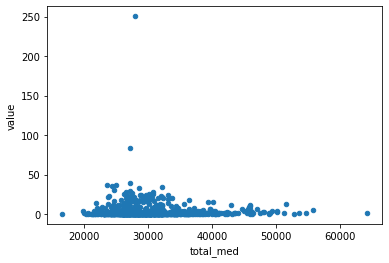

In [73]:
merged_df_U = merged_df[(merged_df['chemical_species'] == 'Uranium')]
ax1 = merged_df_U.plot.scatter(x='total_med', y='value')

**This is the first relationship between total med of earnings and the value of contaminants. No relationship can be found a priori.**

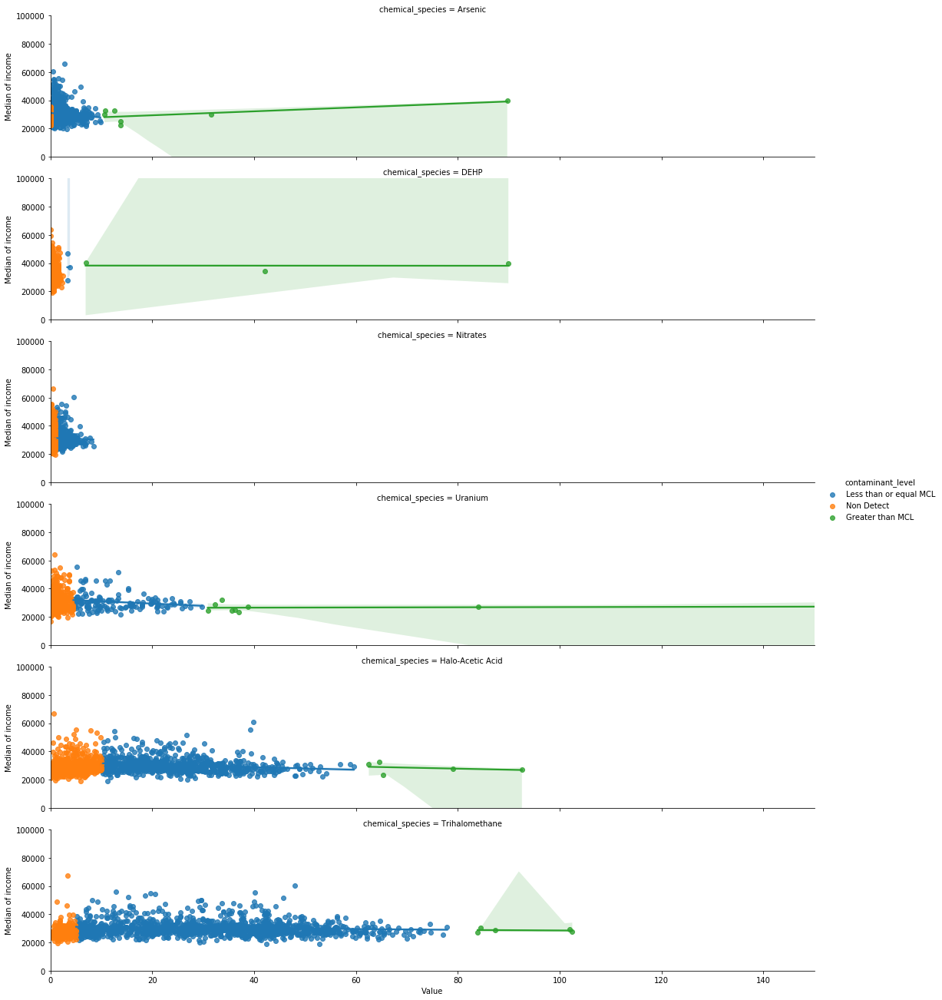

In [74]:
g = sns.FacetGrid(merged_df, row='chemical_species', hue='contaminant_level', aspect=5)
g.map_dataframe(sns.regplot, y="total_med", x="value")
g.set_axis_labels("Value","Median of income")
g.add_legend()
g.set(xlim=(0, 150))
g.set(ylim=(0, 100000))

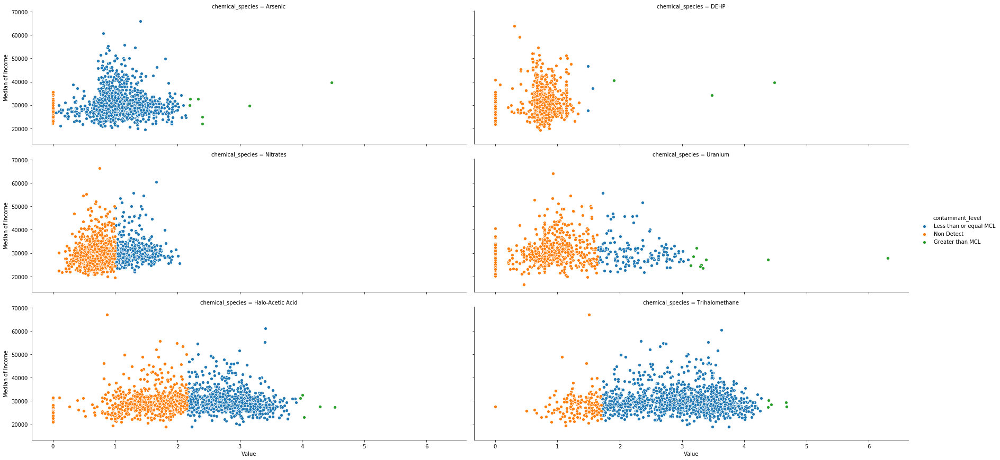

In [75]:
merged_df['log_total_med']=np.log(merged_df['total_med'])
merged_df['adj_value']=merged_df['value']**(1/3)

g = sns.FacetGrid(merged_df, col='chemical_species', hue='contaminant_level', col_wrap=2, height=4, aspect=3)
g.map_dataframe(sns.scatterplot, x="adj_value", y="total_med")
g.set_axis_labels("Value","Median of Income")
g.add_legend()

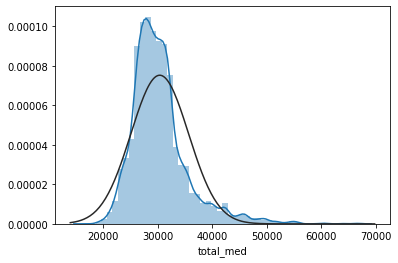

In [77]:
sns.distplot(merged_df["total_med"],fit=stats.norm, kde=True)

In [78]:
income, fitted_lambda = stats.boxcox(merged_df["total_med"])
print(fitted_lambda
     )

-1.3656098900049911


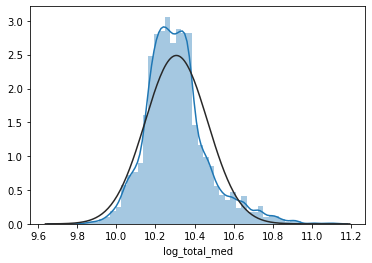

In [79]:
sns.distplot(merged_df["log_total_med"],fit=stats.norm, kde=True)


In [80]:
merged_df["log_total_med"].describe()

count    7554.000000
mean       10.307087
std         0.160328
min         9.716977
25%        10.205628
50%        10.291467
75%        10.378287
max        11.114540
Name: log_total_med, dtype: float64

### Posible Outliers

In [81]:
np.mean(merged_df["log_total_med"])+3*np.std(merged_df["log_total_med"])

10.788039452631963

In [82]:
np.mean(merged_df["log_total_med"])-4*np.std(merged_df["log_total_med"])

9.665817328784428

In [83]:
print(merged_df[merged_df.log_total_med>10.94]['fips'].unique())
merged_df[merged_df.log_total_med>10.94]

['24027' '35028']


,fips,state,chemical_species,pop_served,value,total_med,contaminant_level,log_total_med,adj_value
3059,24027,Maryland,Arsenic,170.000000,0.530000,60639.500000,Less than or equal MCL,11.012702,0.809267
3060,24027,Maryland,DEHP,170.000000,0.060000,59205.000000,Non Detect,10.988761,0.391487
3061,24027,Maryland,Halo-Acetic Acid,247068.000000,39.817942,61071.000000,Less than or equal MCL,11.019792,3.414755
3062,24027,Maryland,Nitrates,158.333333,4.588333,60409.000000,Less than or equal MCL,11.008893,1.661696
3063,24027,Maryland,Trihalomethane,247056.666667,47.978435,60409.000000,Less than or equal MCL,11.008893,3.633697
4605,35028,New Mexico,Arsenic,25000.000000,2.750000,65935.000000,Less than or equal MCL,11.096425,1.401020
4606,35028,New Mexico,DEHP,25000.000000,0.030000,63819.666667,Non Detect,11.063817,0.310723
4607,35028,New Mexico,Halo-Acetic Acid,25000.000000,0.663333,67140.333333,Non Detect,11.114540,0.872122
4608,35028,New Mexico,Nitrates,25000.000000,0.417143,66332.000000,Non Detect,11.102428,0.747185
4609,35028,New Mexico,Trihalomethane,25000.000000,3.403333,67140.333333,Non Detect,11.114540,1.504186


In [84]:
print(merged_df[merged_df.log_total_med<9.66]['fips'].unique())
merged_df[merged_df.total_med<9.66]

[]


,fips,state,chemical_species,pop_served,value,total_med,contaminant_level,log_total_med,adj_value


* 24027 - Howard - Maryland
* 35028 - Los Alamos - New Mexico

In [85]:
#df_earnings[(df_earnings.fips=='35028')]
            #& (df_earnings.year==2014)]

In [ ]:
#df_earnings[(df_earnings.fips=='24027')]
            #& (df_earnings.year==2014)]

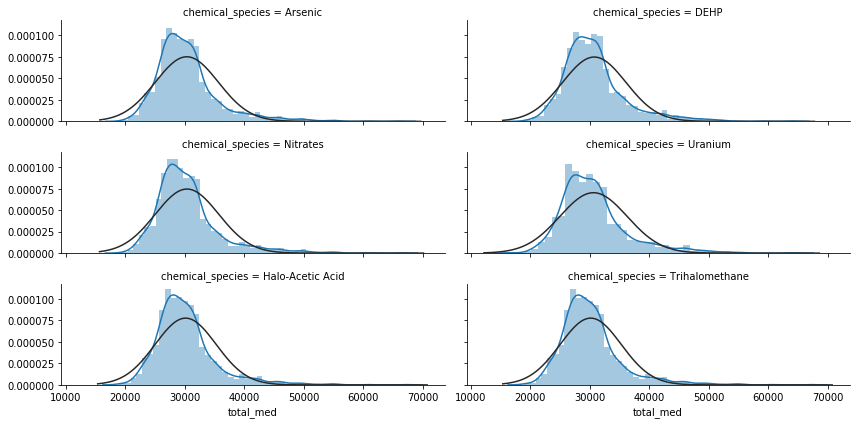

In [86]:
g = sns.FacetGrid(merged_df, col='chemical_species', col_wrap=2, height=2, aspect=3)
g.map(sns.distplot, "total_med",fit=stats.norm, kde=True)
#g.set_axis_labels("Value","Median of Income")
#g.add_legend()

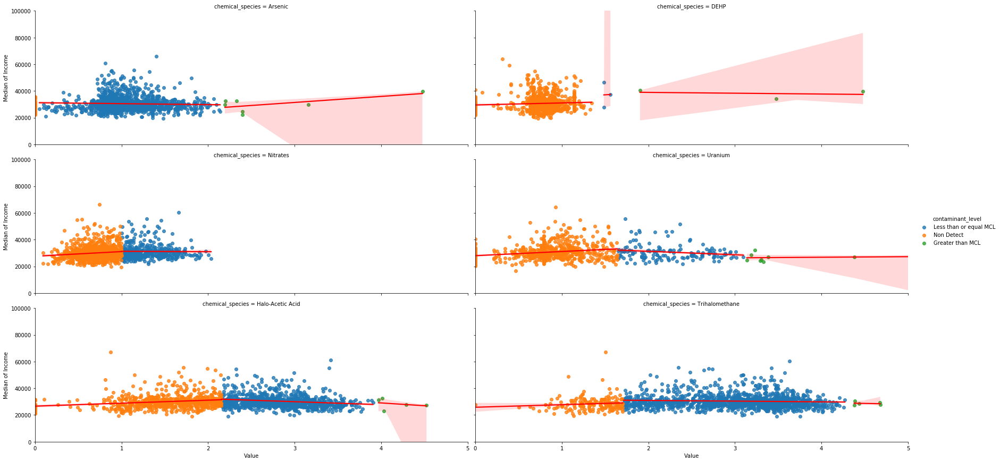

In [87]:
g = sns.FacetGrid(merged_df, col='chemical_species', hue='contaminant_level', col_wrap=2, height=4, aspect=3)
g.map_dataframe(sns.regplot, x="adj_value", y="total_med", line_kws={'color':'r'})
g.set_axis_labels("Value","Median of Income")
g.add_legend()
g.set(ylim=(0, 100000))
g.set(xlim=(0, 5))

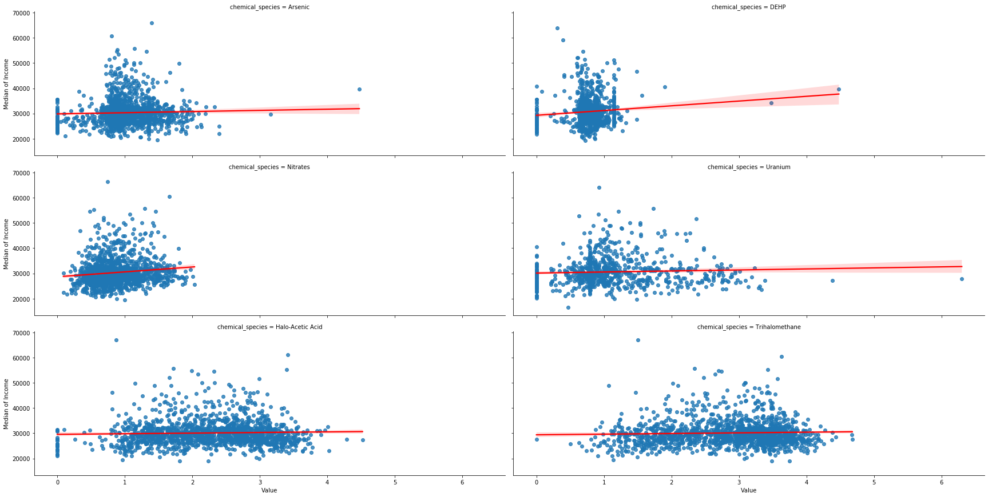

In [88]:
g = sns.FacetGrid(merged_df, col='chemical_species', col_wrap=2, height=4, aspect=3)
g.map_dataframe(sns.regplot, x="adj_value", y="total_med", line_kws={'color':'r'})
g.set_axis_labels("Value","Median of Income")
g.add_legend()

**It seems that high values of pollutants presented in water resources are associated with low values of mean earnings. This is more evident in Arsenic, Halo-Acetic Acid and Trihalomethane pollutants.**

In [ ]:
pd.plotting.scatter_matrix(merged_df[['value', 'total_med']], alpha=0.2)

**No relationship can be found a priori in this plot.**

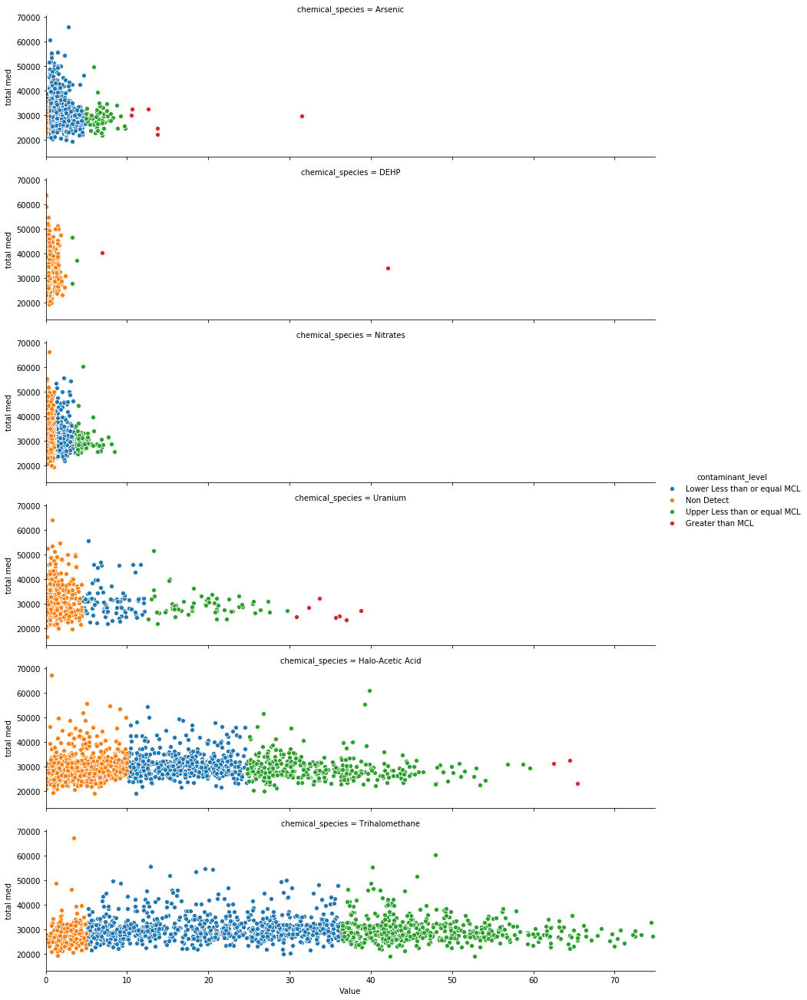

In [93]:
for chem in list(merged_df.chemical_species.unique()):
    ranged = merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].max() - merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].min()
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value > ranged/2), 'contaminant_level'] = 'Upper Less than or equal MCL'
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value <= ranged/2), 'contaminant_level'] = 'Lower Less than or equal MCL'

g = sns.FacetGrid(merged_df, row='chemical_species', hue='contaminant_level', aspect=4)
g.map_dataframe(sns.scatterplot, y="total_med", x="value")
g.set_axis_labels("Value","total med")
g.add_legend()
g.set(xlim=(0, 75))

Since no relationship was found in the previous plot, a series of scatter plots by year and by pollutant are ploter with hue according to the contaminant level. A new scale was proposed to divide the original range in greater than MCL, upper bound less than MCL, lower bound less than MCL and no detected. There is a clear trend of red dots (greater than MCL= values to lie in zones where the median earning is low. 

In [113]:
for chem in list(merged_df.chemical_species.unique()):
    ranged = merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].max() - merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].min()
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value > ranged/2), 'contaminant_level'] = 'Upper Less than or equal MCL'
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value <= ranged/2), 'contaminant_level'] = 'Lower Less than or equal MCL'

g = sns.FacetGrid(merged_df[merged_df['contaminant_level'] == 'Non Detect'], row='chemical_species', hue='contaminant_level', aspect=3)
g.map_dataframe(sns.scatterplot, y="total_med", x="value")
g.set_axis_labels("Value","total med")
g.add_legend()

AttributeError: 'DataFrame' object has no attribute 'chemical_species'

No detected contaminant category has a trend with the total earnings of the county? It is demonstrated that no detected pollutants values are pre3sent in a diverse range of total earnings values and no pattern can be extracted. 

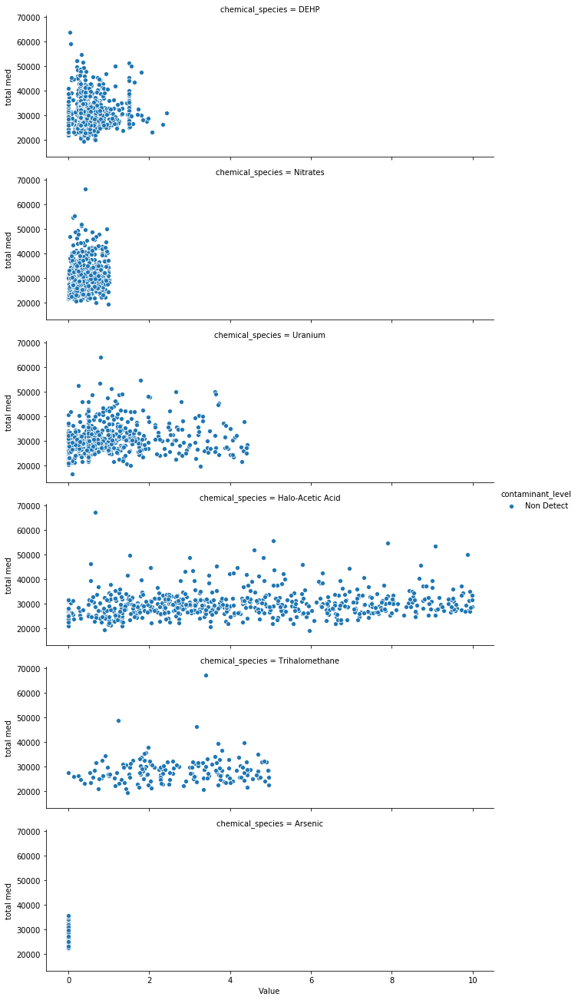

In [90]:
for chem in list(merged_df.chemical_species.unique()):
    ranged = merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].max() - merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].min()
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value > ranged/2), 'contaminant_level'] = 'Upper Less than or equal MCL'
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value <= ranged/2), 'contaminant_level'] = 'Lower Less than or equal MCL'

g = sns.FacetGrid(merged_df[merged_df['contaminant_level'] == 'Non Detect'], row='chemical_species', hue='contaminant_level', aspect=3)
g.map_dataframe(sns.scatterplot, y="total_med", x="value")
g.set_axis_labels("Value","total med")
g.add_legend()

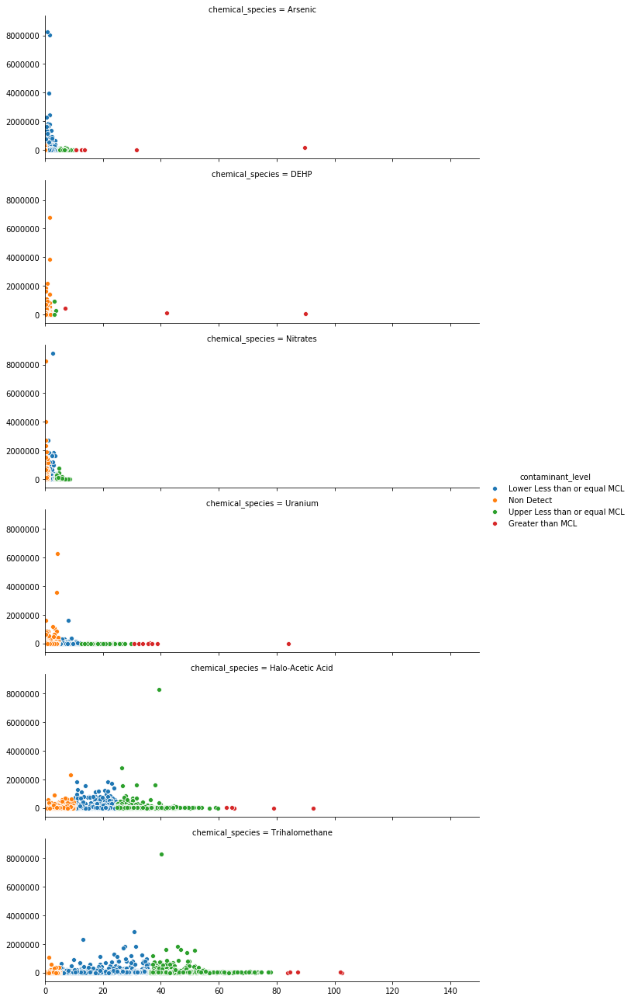

In [91]:
for chem in list(merged_df.chemical_species.unique()):
    ranged = merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].max() - merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].min()
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value > ranged/2), 'contaminant_level'] = 'Upper Less than or equal MCL'
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value <= ranged/2), 'contaminant_level'] = 'Lower Less than or equal MCL'

g = sns.FacetGrid(merged_df, row='chemical_species', hue='contaminant_level', aspect=3)
g.map_dataframe(sns.scatterplot, y="pop_served", x="value")
g.add_legend()
g.set(xlim=(0, 150))
#g.set(ylim=(0, 500))

Water sources with pollutants seem to serve to relatively low number of persons. In order to evaluate counties or states without bias, it is a must to ponderate contaminants with population serve so than the real impact can be identified. 

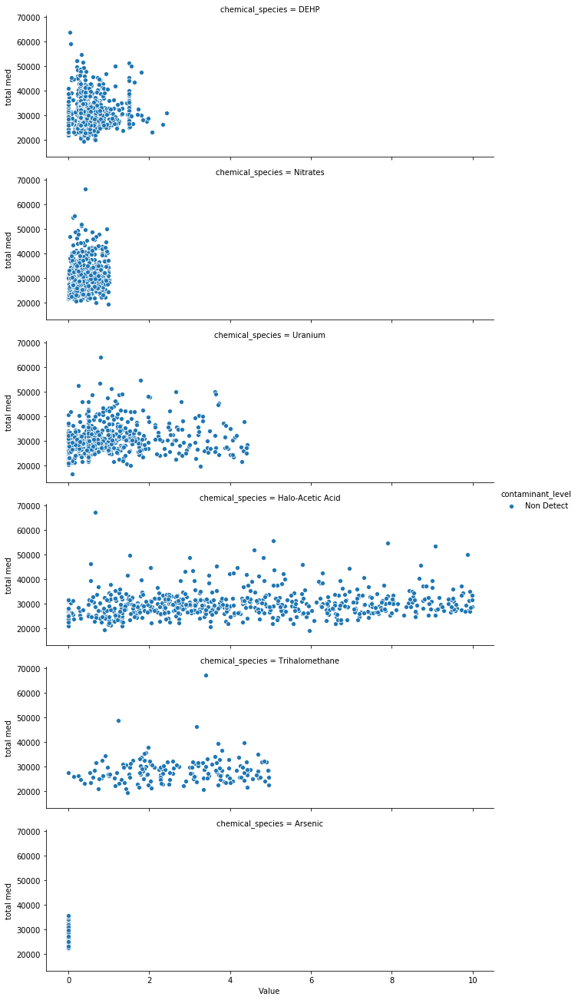

In [92]:
for chem in list(merged_df.chemical_species.unique()):
    ranged = merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].max() - merged_df[(merged_df['chemical_species'] == chem) & (merged_df['contaminant_level'] == 'Less than or equal MCL')]['value'].min()
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value > ranged/2), 'contaminant_level'] = 'Upper Less than or equal MCL'
    merged_df.loc[(merged_df.chemical_species == chem) & (merged_df.contaminant_level == 'Less than or equal MCL')  & (merged_df.value <= ranged/2), 'contaminant_level'] = 'Lower Less than or equal MCL'

g = sns.FacetGrid(merged_df[merged_df['contaminant_level'] == 'Non Detect'], row='chemical_species', hue='contaminant_level', aspect=3)
g.map_dataframe(sns.scatterplot, y="total_med", x="value")
g.set_axis_labels("Value","total med")
g.add_legend()

## Preparing for Linear Regression

### Pivot table - Chemicals

In [102]:
#Pivot table to have the measured value of chemical contamination expressed as a column.
merged_df=pd.pivot_table(merged_df, 
                           index=['fips','state'],
                           columns=['chemical_species'],
                           values='value'
                          )
merged_df.reset_index(inplace=True)

#Merge the median of income from the original dataset.
temp=df_earnings.groupby('fips').agg({'total_med':'mean'})
merged_df = merged_df.merge(temp, how = 'left', on ='fips')
del temp

### Merge the Region

In [103]:
merged_df['region'] = merged_df['state'].map(regions)
#merged_df

NameError: name 'regions' is not defined

### Merge the population

In [104]:
merged_df=merged_df.merge(df_fips_population_year,how='inner',on='fips')
#merged_df

NameError: name 'df_fips_population_year' is not defined

### Merge Political Party

In [105]:
#Merge the Political Party
temp=P[['fips','party']]
merged_df = merged_df.merge(temp, how = 'left', on ='fips')
del temp

NameError: name 'P' is not defined

### Merge Industries

In [106]:
#Averages the Industries Data Set
df_industry_adj= pd.pivot_table(df_industry, 
                            index='fips',
                            values=industries,
                            aggfunc=np.mean)

for i in df_industry_adj.keys():
    if i != 'total_employed':
        df_industry_adj[i] = df_industry_adj[i]/df_industry_adj['total_employed']
df_industry_adj.drop(columns='total_employed',inplace=True)

#for i in df_industry_adj.keys():
#        if i != 'total':
#            df_industry_adj['total'] += df_industry_adj[i]
        
df_industry_adj.fillna(0,inplace=True)
df_industry_adj

NameError: name 'industries' is not defined

In [107]:
merged_df_2=merged_df.merge(df_industry_adj,how='left',on='fips')
#merged_df_2.fillna(0,inplace=True)
merged_df_2

NameError: name 'df_industry_adj' is not defined

In [100]:
#Recognition of the variables available
print(merged_df.info())
print()

#Null observations checking.
print(merged_df.isnull().any())

#Null observations counting.
print(merged_df.isnull().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7554 entries, 0 to 7553
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   fips               7554 non-null   object 
 1   state              7554 non-null   object 
 2   chemical_species   7554 non-null   object 
 3   pop_served         7554 non-null   float64
 4   value              7554 non-null   float64
 5   total_med          7554 non-null   float64
 6   contaminant_level  7554 non-null   object 
 7   log_total_med      7554 non-null   float64
 8   adj_value          7554 non-null   float64
dtypes: float64(5), object(4)
memory usage: 531.3+ KB
None

fips                 False
state                False
chemical_species     False
pop_served           False
value                False
total_med            False
contaminant_level    False
log_total_med        False
adj_value            False
dtype: bool
fips                 0
state                0
chemi

## Linear Regressions

### Case 1: Without Uranium & fill NaN with Average

In [108]:
df_case1=merged_df.drop(columns='Uranium')
df_case1_adj = pd.get_dummies(df_case1['region'])
df_case1_2=pd.concat([df_case1,df_case1_adj],axis=1)
df_case1_2['party']=df_case1_2['party'].map({'democrat':0,'republican':1})
#df_case1_2

from sklearn.impute import SimpleImputer
imp = SimpleImputer(missing_values=np.nan, strategy='mean')#, axis=0)
imp.fit(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic']])
df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic']] = imp.transform(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic']])
#df_case1_2

df_case1_2

KeyError: 'region'

In [109]:
#Recognition of the variables available
print(df_case1_2.info())
print()

#Null observations checking.
print(df_case1_2.isnull().any())

#Null observations counting.
print(df_case1_2.isnull().sum())

NameError: name 'df_case1_2' is not defined

In [110]:
from sklearn.linear_model import Lasso
lasso = Lasso(alpha=0.1, normalize=True)
lasso_coef = lasso.fit(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic', 'population',         
'party',             
'Midwest',           
'Northeast',           
'Northwest',          
'Pacific',              
'Southeast',           
'Southwest']], df_case1_2.total_med).coef_


_ = plt.plot(lasso_coef)

lasso_pred = lasso.predict(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic', 'population',         
'party',             
'Midwest',           
'Northeast',           
'Northwest',          
'Pacific',              
'Southeast',           
'Southwest']])
lasso.score(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic', 'population',         
'party',             
'Midwest',           
'Northeast',           
'Northwest',          
'Pacific',              
'Southeast',           
'Southwest']],  df_case1_2.total_med)
lasso.get_params

NameError: name 'df_case1_2' is not defined

In [111]:
from sklearn.linear_model import Lasso
lasso = Lasso(alpha=0.1, normalize=True)
lasso_coef = lasso.fit(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic']], df_case1_2.total_med)


# _ = plt.plot(lasso_coef)
lasso_pred = lasso.predict(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic']])
lasso.score(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic']],  df_case1_2.total_med)

NameError: name 'df_case1_2' is not defined

In [ ]:
from sklearn.neural_network import MLPRegressor
ANN = MLPRegressor(hidden_layer_sizes=500, random_state=1, max_iter=1000, early_stopping=True, activation='logistic', warm_start=True)
ANN = ANN.fit(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic', 'population',         
'party',             
'Midwest',           
'Northeast',           
'Northwest',          
'Pacific',              
'Southeast',           
'Southwest']], df_case1_2.total_med)
ANN.predict(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic', 'population',         
'party',             
'Midwest',           
'Northeast',           
'Northwest',          
'Pacific',              
'Southeast',           
'Southwest']])
ANN.score(df_case1_2[['DEHP', 'Trihalomethane', 'Nitrates', 'Halo-Acetic Acid', 'Arsenic', 'population',         
'party',             
'Midwest',           
'Northeast',           
'Northwest',          
'Pacific',              
'Southeast',           
'Southwest']], df_case1_2.total_med)

### Case 2: Without Uranium and DEHP & drop NaN in other Chemicals

In [ ]:
merged_df_2

df_case2 = merged_df.copy()
#df_case2 = df_case2.drop(columns=['Uranium','DEHP'])
df_case2 = df_case2.drop(columns='Uranium')
df_case2.dropna(inplace=True)
df_case2.reset_index(inplace=True)
df_case2_adj = pd.get_dummies(df_case1['region'])
df_case2=pd.concat([df_case2,df_case2_adj],axis=1)
df_case2.dropna(inplace=True)
df_case2.rename(columns={'Halo-Acetic Acid':'Halo_Acetic_Acid'}, inplace=True)
df_case2

In [ ]:
sns.distplot(df_case2["population"],fit=stats.norm, kde=True)

In [112]:
income, fitted_lambda = stats.boxcox(df_case2['population'])
print(fitted_lambda)

NameError: name 'df_case2' is not defined

In [ ]:
df_case2["log_population"] = np.log(df_case2["population"])
sns.distplot(df_case2["log_population"],fit=stats.norm, kde=True)

In [ ]:
mod2_1 = smf.ols(formula='np.log(total_med) ~ Arsenic + DEHP + Halo_Acetic_Acid + Nitrates + Trihalomethane + np.log(population) + party + Midwest + Northeast + Northwest + Pacific + Southeast + Southwest', data=df_case2).fit()
print(mod2_1.summary())

In [ ]:
mod2_2 = smf.ols(formula='np.log(total_med) ~ Nitrates + np.log(population) + party + region', data=df_case2).fit()
print(mod2_2.summary())

In [98]:
sm.qqplot(mod2_1.resid, line="s");

NameError: name 'mod2_1' is not defined

### Another

In [97]:
df_case2 = merged_df_2.copy()
#df_case2 = df_case2.drop(columns=['Uranium','DEHP'])
df_case2 = df_case2.drop(columns='Uranium')
df_case2.dropna(inplace=True)
df_case2.reset_index(inplace=True)
df_case2_adj = pd.get_dummies(df_case1['region'])
df_case2=pd.concat([df_case2,df_case2_adj],axis=1)
df_case2.dropna(inplace=True)
df_case2.rename(columns={'Halo-Acetic Acid':'Halo_Acetic_Acid'}, inplace=True)
df_case2

NameError: name 'merged_df_2' is not defined

In [ ]:
mod3_1 = smf.ols(formula='np.log(total_med) ~ Arsenic + DEHP + Halo_Acetic_Acid + Nitrates + Trihalomethane + np.log(population) + party + region + agriculture + construction + manufacturing + wholesale_trade + retail_trade + transport_utilities + information + finance_insurance_realestate + prof_scientific_waste + edu_health + arts_recreation + other + public_admin', data=df_case2).fit()
print(mod3_1.summary())

In [ ]:
mod3_2 = smf.ols(formula='np.log(total_med) ~ Arsenic + np.log(population) + region + agriculture + construction + manufacturing + wholesale_trade + retail_trade + information + finance_insurance_realestate + prof_scientific_waste + arts_recreation + other + public_admin', data=df_case2).fit()
print(mod3_2.summary())
'''
1. Halo_Acetic_Acid
2. transport_utilities
3. edu_health
4. DEHP
5. party
6. Nitrates
7. Trihalomethane


'''

In [ ]:
sm.qqplot(mod2_1.resid, line="s");

In [ ]:
### Case 3: Drop

#### Investigative Depth

In [94]:
print (merged_df['contaminant_level'].unique())
c1=merged_df[merged_df.contaminant_level=='Non Detect'].total_med
c2=merged_df[merged_df.contaminant_level=='Upper Less than or equal MCL'].total_med
c3=merged_df[merged_df.contaminant_level=='Lower Less than or equal MCL'].total_med
c4=merged_df[merged_df.contaminant_level=='Greater than MCL'].total_med

['Lower Less than or equal MCL' 'Non Detect'
 'Upper Less than or equal MCL' 'Greater than MCL']


In [95]:
statistic, pvalue = stats.ttest_ind(c1,c2, equal_var=False)
print(statistic, pvalue)
statistic, pvalue = stats.ttest_ind(c1,c3, equal_var=False)
print(statistic, pvalue)
statistic, pvalue = stats.ttest_ind(c1,c4, equal_var=False)
print(statistic, pvalue)
statistic, pvalue = stats.ttest_ind(c2,c3, equal_var=False)
print(statistic, pvalue)
statistic, pvalue = stats.ttest_ind(c2,c4, equal_var=False)
print(statistic, pvalue)
statistic, pvalue = stats.ttest_ind(c3,c4, equal_var=False)
print(statistic, pvalue)

3.4234917768717894 0.0006318528179182482
-4.381733795030658 1.1966742629374603e-05
0.9428754639430778 0.3536514224054611
-6.59845001089506 5.3086186937242037e-11
0.2783924938513342 0.782648355363499
1.5925632165735029 0.12221677000827144


In [96]:
temp=merged_df[merged_df.year>2015]
m1 = ols('total_med ~ year', data=temp).fit()  
aov_table = sm.stats.anova_lm(m1, typ=2)
print(aov_table)

AttributeError: 'DataFrame' object has no attribute 'year'

In [ ]:
m1 = ols('total_med ~ contaminant_level', data=merged_df).fit()  
aov_table = sm.stats.anova_lm(m1, typ=2)
print(aov_table)
print()
m2 = ols('total_med ~ contaminant_level + chemical_species + contaminant_level*chemical_species', data=merged_df).fit()  
aov_table2 = sm.stats.anova_lm(m2, typ=2)
print(aov_table2)
print()
print(merged_df[merged_df.contaminant_level=='Non Detect'].total_med.describe())
print()
print(merged_df[merged_df.contaminant_level=='Upper Less than or equal MCL'].total_med.describe())
print()
print(merged_df[merged_df.contaminant_level=='Lower Less than or equal MCL'].total_med.describe())
print()
print(merged_df[merged_df.contaminant_level=='Greater than MCL'].total_med.describe())

* In All the p.values are almost zero, we rejact the null hypothesis in the 4 cases of contaminants. So, we conclude that there is not enough statistical evidence to say for sure that any null hypothesis is false.
* The total median earnings per county its different depending on the level of contamination of the water
* The p.value have to be almost zero again, we rejact the null hypothesis. So, we conclude that there is not enough statistical evidence to say for sure that null hypothesis is false.

### MODELOS


1. Ingresos_Medios_County (Earnings): population X Chemicals value (6) X Interacción
2. Ingresos_Medios_County (Earnings): Importancia_Industria_Población_activa (Industry)
3. Ingresos_Medios_County (Earnings): Importancia_Industria_Población_activa (Industry) X Chemicals value (6) X Interacción
4. Ingresos_Medios_County (Earnings): Importancia_Industria_Población_activa (Industry) X Chemicals value (6) X Interacción X population_served

CRISTHIAN	1
JULIAN	2
MARGARITA	3
JOHAM	4
LEONARDO	4
